## Lecture 1. Intro

Questions (mine) to the lecture (to repeat; cover the notes below and answer this questions):
1. 

Notes, by slides (numbers):

3. CV is
    - Building systems that process, perceive, reason about visual data.
4. CV important? 
    - Everywhere. Instagram. Photos. Smartphones.
    - Massive. We don't have human power to process this data. 
    - Will continue to improve.
5. Learning is 'learning from data and experience'. 
6. DL. Hierarchical learning algos with many layers.
13. DL subset of ML. Intercects with CV. ML is subset of AI. CV and ML is this class focus.
15. History. Hubel and Wiesel. 1959. Wanted to understand how brain work.





## Lecture 2. Image classification (I.C.).


Notes. By slides:

11. Image classification is by image getting ordered labels. Computer doesn't have our intuition about pictures. It sees giant number of bits, grid. 3 channels of RGB by 2 dim. 

13-19. Challenge is variations:

    - Viewpoint. Camera moves.
    - Intraclass variation. Different cats.
    - Fine-grained categories. Breeds of cats.
    - Background clutter. Snow. At sand.
    - Illumination changes. In dark. In light.
    - Deformation. Poses. 
    - Occlusion. Hidden by things. A tail of cat from a cusion of a couch.
    
20. I.C. very useful: medical, whale recognition, galaxy classfication, etc. See Kaggle Challenge.

21-28. Helpful for other tasks in CV.
    - Object Detection: boxes around things. A way is to classify by frames of the image (moving box).
    - Image captioning. Describe an image. Sequence of labels. What word should I say next. 
    - Play GO. Where to play next? (Why?) Input: position. Output: which position should I play.
    
29-31. How I.C.? Not obvious. Given im. Out: class.

30. Try fidning edges? They find corners? But how next? But because of variations it doesn't work.
31. ML, Data-Driven approach. Pipeline:
    1. Collect images and labels.
    2. Use ML to train classifier. Train(..)
    3. Evaluate on new images. Predict(..)
        
32-40. Data sources for it? 
    - MNIST. 50k images. 28x28. Not enough
    - CIFAR10. 50k images. 10 classes. 32x32 rgb.
    - CIFAR100. 100 classes. 50k images. 32x32 rgb. 154M pixels.
    - ImageNet. Gold standard. ~1.3M. Top 5 accuracy: if one of 5 is correct then good. 251B pixels
    - MIT Places. ~8M training images. Places365. 1.6T pixels.
    - Omniglot dataset. Learn from little data. 1623 categories: char from 50 diff alphabets. 20 images per cat.
    
41-.. Nearest Neighbor. 

41. Naive approach:
    - Train() : memorize all data.
    - Predict(): Compare with all set and return the label of the most similar image.
    - Need func to compare two images. 
        - L1 (Manhattan) dist. Sum(Abs(img_1 - img_2))
    - Training time? O(1)
    - Testing time? O(N)
    - Bad timing.
    - But there are optimizations. facebookresearch/faiss
    - Results: not so smart. 4 out of 10 are correct for cifar10.
    
54-59. Dicision Boundaries. How to view this in another way? 
    - Representation:
        - Picture: 2 axes, colored regions, dots there.
        - Axes - this is two pixels from one image. 
        - Colored regious - learned from training set. 
        - Dots - examples.
        - Boundaries between regious.
    - Problems: a small region inside another region; jagged or noisy boundary.
    
61. How to improve decison boundaries? 
    Instead of taking from 1 nearest nebour take the color of a regious from K nearest neighbours (majority decides).
    Advantages? With k = 3. Smoother. Less noice on boundaries. But: now some unclassified regions.
    
65. Diff distance metric. Use L2 Euclidean distance. sqrt(sum((img_1 - img_2)^2))

- Choosing L1 or L2 is hyperparam. L2 might be more intuitive.
    - K-Nearest Metric can be used elsewhere. Can write our own distance metric. 
- Pdf files. Uses tf-idf similarity. For freq. of words.

70. Demo for KNN.

71-79. Hyperparams: - Best val for K? Best distance metric?
    How? Try diff and decide 

- Ideas to choose:
    - On all dataset? Bad as on new data doesn't work. Always K=1 but on new
    - Train and test? Choose on test data. Bad as learn on test data!
    - Train, validation, test. Better! Touch test data only once. Example: months work on train and validation sets and only before a week only then on the test set. This is right.
    - Cross-validation. Best idea. Split non-test data into chunks, pick up one (iteratively or randomly) for validation and others for training. Better but expensive. 
- Cross validation example. Graph with accuracy for diff K.
    
80. Universal Approximation. If K -> infinity? If training samples to infinity? Then it represents any function (but technical issues).
- But there is a curse! Curse of dimensionality. Number of training points grows exponentially! 
    But internet is big? No! Consider 32*32 images: 2^(32*32) ~= 10^308. And particles of visible uni: 10^97.
        
88. KNN very rarely used. 
    - Very slow at test time.
    - Hard to collect data.
    - Distance metric not informative if on raw pixels.
    - But NN works on ConvNet features ! Not on raw pixels.
        - That's a strong baseline.
        - Image captioning work with NN.



Questions

11. What's image classification (I.C) problem?
13-19. What challenges in I.C.?
20. Where I.C. used?
21-28. To what ML problems I.C. transfers?
29. Basic code template of I.C.?
    30. Naive approach?
    31. Main methods?
32-40. Data sources for I.C.?
41-88. NN (nearest neigbour).

41. Naive approach. Why bad?
54. Decision boundaries representation? What are colors? 
    59. Problems if K = 1?
61. How to improve?
    - Nearest K neighbors? Advantages?
65. Different distance metrics? L1? L2?
    67. What other domain specific distance metrics?
70. How to choose hyperparameters? Name ways. And their cons. How to divide data?
79. Cross validation. Pros and cons?
80. If K -> infinitiy? Universal approximation? What's curse of dimensionality?
88. Is KNN used anywhere? 
    On raw pixels? 
    With other features (not raw pixels, features from ConvNet)?


## Lecture 3. Linear Classifiers. Softmax / SVM classifiers. L2 regularization.

2022-07-12

/*
Previously (mit 6.036):
Loss func hinge = max(0, 1 - v), v = y_i*(theta.T @ X_i)
Now:
Loss func hinge = max(0, s_j - s_{y_i} + 1), v = y_i*(theta.T @ X_i)
*/


Notes, by slides:

4. Recap. CV challenges. Domain-Driven approach. kNN.
7. NNs cosists of very similar things as Linear classifiers (LC).
9. LC idea: parametric approach
10. For Cifar10.

    $ f(x, W) = W x + b $ 

    In: image $x$ 
    With: $W$ - parameters or weights
    Output: 10 class scores

13. Example. Cat image. $x$ - is flattened image (2x2 into 4x1).

```
      W    @  x   +   b    =   f
    (3, 4)   (4,)    (3,)     (3,)
```

16. Bias Trick. Add to x additional row with '1' value. Then W can be added with 'b'.
    But not useful in ConvNN. Nevertheless good to think about it in geometric way.
    
    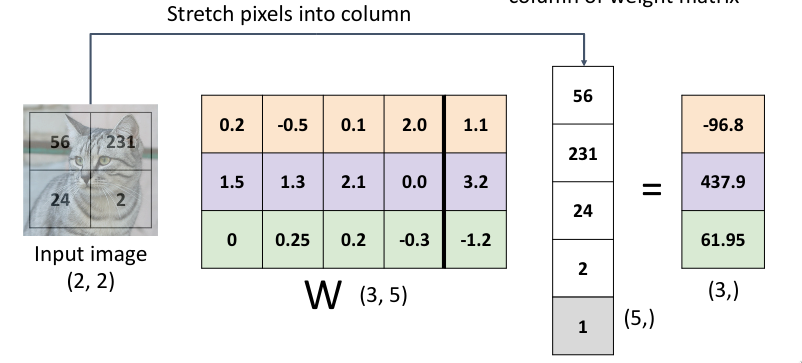
    
17. Predications are Linear. We can put out of paranthesis a scalar. Meaning that the same score.

    $f(c*x, W) = W @ c*x = c*f(x, W)$

    Example: is graying an image with 0.5. Then the same scores but scaled.

19. Interpreting a LC.
    19. Algebraic Viewpoint. This is when W in rows of hypothesis for each class.
    22. Visual Viewpoint. Shape rows the same as image. Then if we show this image then it shows a 'template' per category. And to get score use inner (dot) product for those 2 matrixes plus the b_i (bias). 
        - Background failure. It turns out that it uses background so it might be more or less probably for the score.
        - Modes failure. Like horses looking in diff directions. Or car of diff colors. 
    25. Geometric Viewpoint. Example for images: score is vertical axis, pixel value is horizontal value. Then the line shows a classifier.
        - Extends to very high dimensiona Euclidian space.
        - But in many dimensions it has flaws, not intuitive.
30. Hard Cases for LC. Examples:
    - 4 squares:
    - Circle in center. Example: 1 < distance < 2
    - Three circles. Three modes. 
    - Also this is XOR problem that Perceptron couldn't categories.
    
    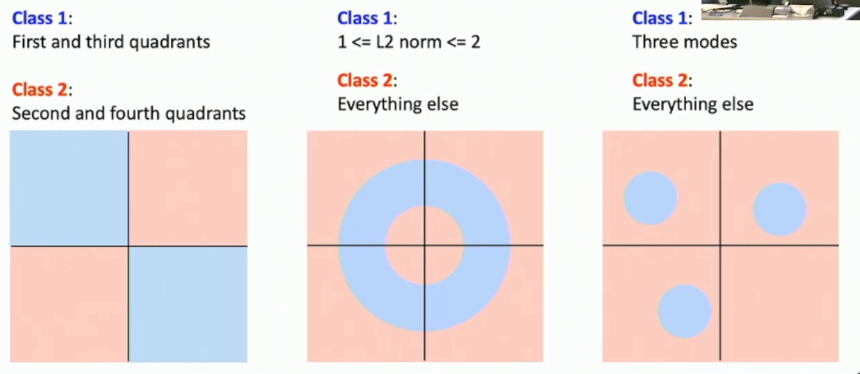

33. We have score function. But how we find W?
    - We need a loss function
    - And algo that optimizes the loss function.
35. Loss func aka objective func or cost func. It is how good our classifier. Low loss - good. High loss - bad.
    - Formally:
    
        $ { (x_i, y_i) },   i=1..N$
        
        $x_i$ - image
        
        $y_i$ - label

        $L_i(f(x_i, W), y_i)$  for single example.

        For entire dataset:

        $L = \sum(L_i(f(x_i, W), y_i)) / N$

40. Muticlass SVM Loss. "Hinge Loss" Intuition: the score of correct class should be higher, i.e. less loss. 

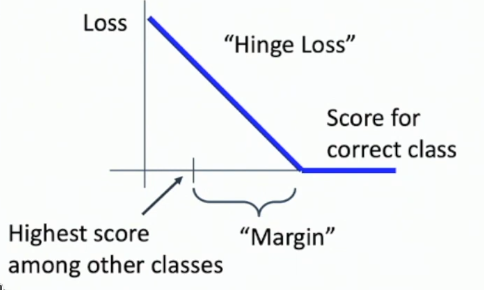

$ L_i = \sum_{j \ne y_i} max(0, s_j - s_{y_i} + 1) $

where $ s = f(x_i, W) $

SVM Loss 'wants' the score for correct class be higher than scores for other classes by some marging ($ \delta $). So that's why it is 0 when $ s_j - s_{y_i} $ is negative, i.e. $ s_j < s_{y_i} $ 

50. More about SVM loss.

- What if we change a score a little bit for correctly classified example? 
     A: Will be 0. Compare with other loss func.
- What's max or min possible values?
    A: Max - inf. Min - 0.
- If scores all random but examples are standardized, then what loss to expect?
    A: Then we might see small loss function.
- What if sum were over all categories (including the correct class)?
    A: The loss will be moved by one (delta), inflated by one.
- What if the loss used a mean instead of a sum?
    A: The preferrence will be the same. Will not effect predictions.
- What if we square the loss? $ L_i = \sum_{j \ne y_i} max(0, s_j - s_{y_i} + 1)^2 $
     A: Then it will be another classifier because weights will be different.
- If we found loss that sum up to zero will it be unique? 
    A: No. Consider if we multiply weights by 2.

So if 2W and W are with same loss how do we find the better hypothesis? Add regularization.

60. Regularization.
- L2 regularization. Multiply every element with every other element in $ W $.
- L1. 
- Other.

Purpose or Regula:
- Express preferences in those models that have the same loss.
- Avoid overfitting.
- Improve optimization. 

64. Regularization: Expressing Preferences

Example. For $ R(W) = \sum_k \sum_l W^2_{k,l} $

66. Regul. Prefer Simpler Models. Avoid overfitting.

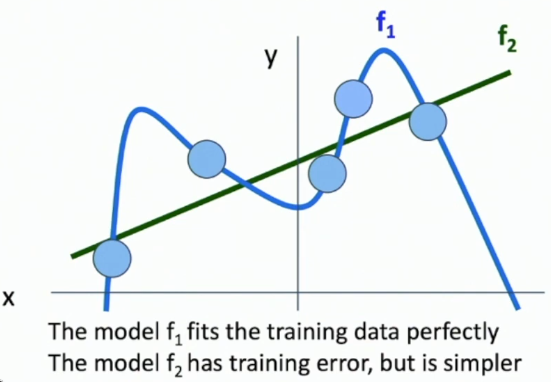

69. Regul. Very important. Always need to add to model.

70. Another Loss func. Cross-Entropy Loss (Multinomial Logistic Regression)

Let's interpret those scores as _probabilities_.

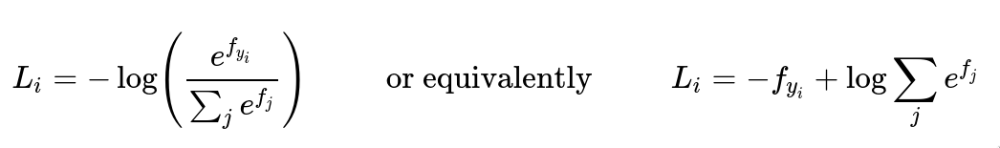

See Information Theory to understand this (Cross Entropy, other).

- What CEL does?
    A: Maximizes probability of correct class.
- What's min/max possible loss $L_j$? 
    A: Min - 0, Max - infinity. But with SVM it was possible to archive 0, but with CEL it is not practical way to get 0. 
- What if all scores random?
    A: $ -log(|Y|) = -log(10) ~= 2.3$ . $|Y|$ - number of categories.
- What if small change?
    A: SVM stays the same. Cross-entropy will change.

Questions:

6. What's idea of linear classifier? 
7. Formula for LC?
9. Bias trick (b vector)
10. What if we scale images? Linear?
11. How can we interpret LC? Name ways. How visual viewpoint is done?
12. Hard cases for LC? Compare with Perceptron?
13. What we need to find weights now as we have the loss func?
14. Idea for the Loss func?
15. Describe Multiclass Loss func (Hinge Loss)
    - What if we change a score a little bit for correctly classified example? 
    - What's max or min possible values?
    - If scores all random but examples are standardized, then what loss to expect?
    - What if sum were over all categories (including the correct class)?
    - What if the loss used a mean instead of a sum?
    - What if we square the loss? $ L_i = \sum_{j \ne y_i} max(0, s_j - s_{y_i} + 1)^2 $
    - If we found loss that sum up to zero will it be unique? 
60. What's regularization? What kinds of it there are?
61. What purposes for the regularization? Name three
70. Cross-Entropy loss func.
    - Describe.
    - What CEL does?
    - What's min/max possible loss $L_j$? 
    - What if all scores random?
    - What if small change?


## Lecture 4. 
Optimization.
Stochastic Gradient Descent.
Momentum, AdaGrad, Adam.
Second-order optimizers .

9. Recap. 
- Score func
- Loss function

How to find best $w$ ? That is $ w^* = argmin_w L(w)$ This is optimization problem. Let's focus only on essentials. 

11. Intuition is walking on a plane and seeking a bottom of this. The peak is the highest loss. 
- Sometime can find solution directly. But usually need a gradual approach.

13. Idea \#1. Random Search. 
- Generate random weights.
- Keep the best one
- Iterate.
- Accuracy for this is ~15.5%. Not bad thought. SOTA is 95%.

16. Idea \#2. Follow the scope. Strategy is step in the direction of greatest decrease. 

- In 1-dimension. It is $ df(x)/dx$
- For multi-dim, it's the gradient.
- The greatest decrease is the opposite to the greatest increase. Inutitive.

19. How to compute gradient?

- Numerical gradient. That is increase a bit on dim of $W$ then get diff for both $f$ of those two $w$, div by this small bit and that tells value of gradient:

$$
dL/dw =
 \begin{bmatrix}
\frac{f(w) - f(w + [w_0 + 0.001, \dots ])}{0.001} \\
\dots
\end{bmatrix}
$$
 
Problem with numerical grad?
- Slow: O(#dim). Inpractical in many dim.
- Approximate. Not accurate.
 
27. Analytic grad. So why not calc gradient? So we could get grad in one operation. It relies on backprop (Lecture 6). Exact, fast, error-prone.

In practice. Analytic grad needs a gradient check. So do it it with a numereric gradient. In assignments: `grad_check_sparse`. In PyTorch: `gradcheck` (and `gradgradcheck` for second derivatives).

35. Gradient Descent. 

```
w = init_w()
for t in range(num_steps):
    dw = comp_gradient(loss_fn, data, w)
    w -= learning_rate * dw
```

Hyperparams. Weights - matter much, there is a proper way. Num of steps - common is to run for a fixed num of iterations,  constrained by resourses. Learning rate - how we trust the grad, how we want to take this grad, can be variable. Those we will learn through out the lectures.

36. Representation. Heat map. Demos.

GD demo on heat map. 
- Does not go straight to the bottom. Kind of curves around the optima. Step size becomes slower as it approaches min as the grad is less there.

Batch Gradient Descent.
For full loss func GD is very expensive. Full loss func is sum div by num of examples. 

38. Stochastic GD (SGD). 

Approximate the sum using minibatches (32 / 64 / 128). Practically almost always used. Now we add batch size (use bigger as u can, not matter too much) and data sampling (can shuffle in beginning and then again; not matter too much) to our hyperparams. 

40. Why stochastic? 

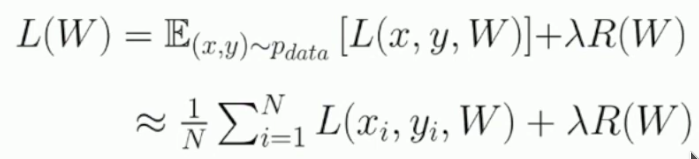

Because now our func is probabilistic. 

42. Problems with SGD

If loss changes quickly in one dir but slowly in another? Slow progress along the shallow dim because it is quick in steep dir. 

- 45. Another prob. Local minimum or saddle point.

In local min we might stop. And won't escape from it.
In saddle point, at the tip of it the grad also the 0, so again stuck. In high dim, saddle points are common.

- 47. Third problem. It is stochastic, it is random. Might be avg towards optimum but not clear. So we need to handle this noise.

49. SGD + Momentum. To handle noise. 

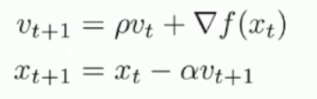

Idea is to track of a velocity. Imaging a ball rolling down a hill. So at every point we have this velocity vector and the gradient. We update the velocity. And use this velocity to update weights. `rho` - friction or decay rate.

```
v = < zero vector >
for t in range(num_steps):
    v = rho * v + dw
    w -= learning_rate * v

```

There are diff formulations (learning rate moved). But they are similar.

Demo. How sgd+momentum helps? Local min might be passed by using a velocity. Similar for saddle points. Also helps with going faster to an optimum. Also it smoothes noise and thus moves faster to center.

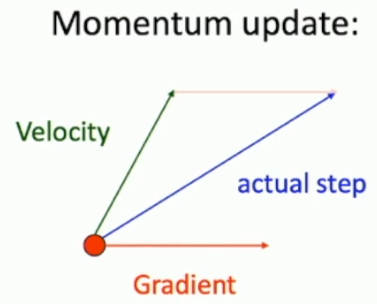

53. Another version of momentum - Nesterov Momentum.

Same historical velocity and gradient. But it 'looks ahead' that is computes gradient for the point where the velocity will take us and then summing this gradient.

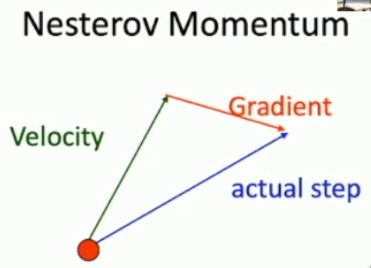

$ v_{t+1} = p v_t - \lambda \bigtriangledown f(x_t + p v_t) $

It is akward for us as it uses future point. And it adds velocity vector instead of subtracting it (as it is with the gradient). So it can be rewritten to allow this.

- 57. Demo. We can see that SGD+Mom and Nesterov overshoot at the bottom going a bit further. 

58. AdaGrad. 

Adaptive learning rates class of optimizations. 

Now it keeps tracking squared gradient and when updating the weights it divides it by square root. Why? It solves the issue when grad changed very fast adagrad will divide by large num so it overcomes this ill conditions. And when grad is small it divides by smaller value so it moves faster.

Problems with AdaGrad? It will decay the progress because the squared sum becomes large. To fix it there is RMSProp.

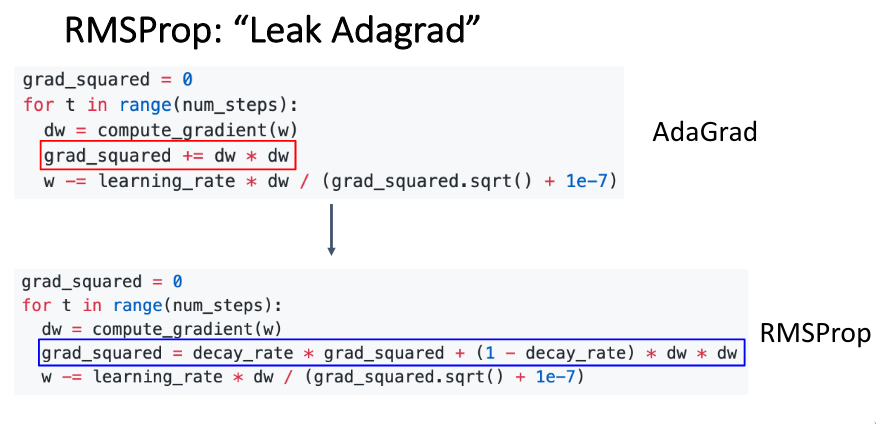

62. RMSProp. 

To fix AdaGrad. It adds a decay_rate. So AdaGrad won't slow down progress.

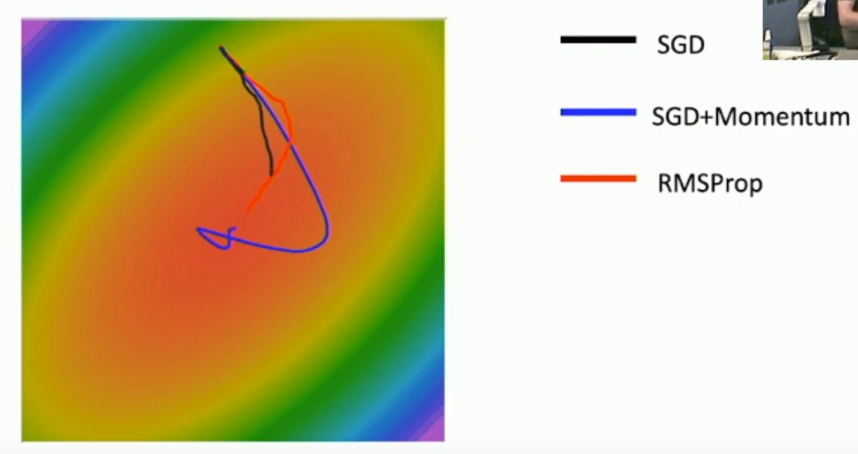

64. Adam.

It is basically RMSProp + Momentum!

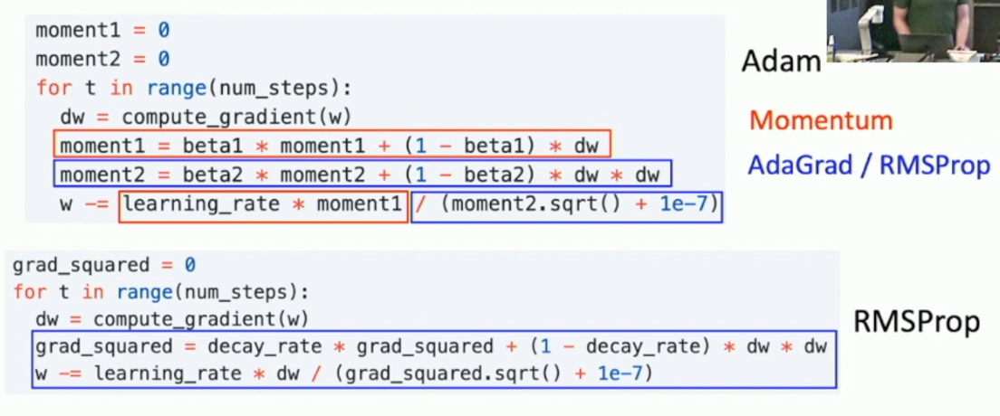

Problem. What happens at t=0? Where beta2 = 0.999. It will divide by very small number and it will take very large step. To fix it Adam adds bias correction. 

This Adam works well in many systems. Used in practice.

Note that in high-dim it works very diff from 2-d as shown on demos.


74. Second Order

First-Order (первая производная) optimization. Uses grad to approximate. Steps to minimize the approximation.

Second-order optim (вторая производная). Grad + hessian (second derivative) to make quadratic approx. Step to min this approximation. So it guesses where to take large or small steps.

See formula.

Why is this imractical? Not computible fast. O(N^3). Where N can be hunreds of millions.

82. In practice.

Adam is good choice. SGD+momentum might outperform but require tuning. 

If can afford second-order, this is L-BFGS. 



### Questions:

11. Intuition behind how to find optimum weights. Name ideas
13. Random Search
16. Follow slope
19. How numerical gradient? What are problems with it?
27. Analytic gradient (backpropogation in lecture 6). How to check analytic gradient?
35. Gradient descent algorithm
    - What are hyperparameters now? How much should we care about those?
36. How to represent GD?
38. Stochastic GD. Describe. Two randomization sources.
40. Why is it stochastic?
42. Problems with SGD? Three problems. 
49. SGD+Momentum. 
- What it solves?
- Idea
- Algorithm
53. Nesterov Momentum
- Idea
- Algo
58. AdaGrad. 
- Idea. What problem it solves.
- Algo
62. RMSProp
- What it fixes in AdaGrad?
64. Adam. 
- Idea behind it?
- What's bias correction?
74. Second Order.
- How it is used?
- Practical? Why?
- Name algo that implements this.

## Lecture 5. NN

6. Problem with Linear Classifiers? Only linear. Can't recognize diff modes (horse looking in diff directions).

7. Solution might be feature transforms. So from original space to feature space. Example is a polar coordinates can represent features in a circled area. So choosing smartly to feature transformation might be more meaningful. 
    
    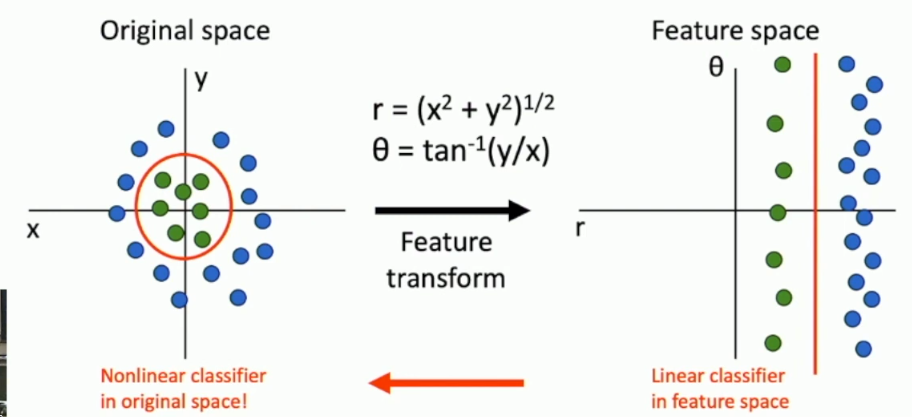
    
    - Another feature transform example - color histogram. This represents types of colors presented, e.g. N green, M blue color value, etc.
    - Another: Histogram of Oriented Gradients (HoG). Computes edge directions for little squares.
    - Another: Bag of Words. Step 1: build codebook (little patches extracted from image). Step 2: encode images using thos batches. And use those as features. 
    - Another: use previous features representation combined. 
    
    This was very widely used around 2010. 
    
    But it is complicated where only the last part of this large system learns. So the deep NN learns from the firsthand data without feature extraction. So NN learns how to extract features and learns on them.
    
22. NN. 

(Before) Linear score function: $ f=W x $

(Now) 2-layer NN: 

$ f = W_2 max(0, W_1 x) $.

So it is functions combination. Generalizable to 3-layer. 

We can visualize it as using lines as at the picture below that goes through rectangles. Then each element projection is denoted as (i, j) which means j-th element from source projected to i-th element in target.

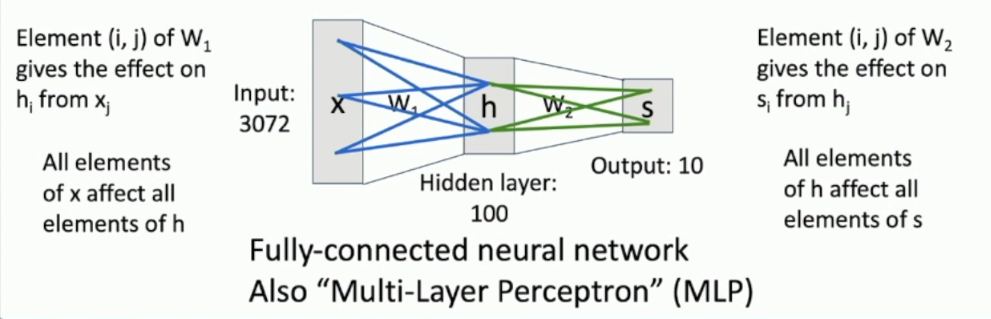
    
This is fully connected as all elements effect all other.

How we can interpret those weights in layers? Unclear, but there is some structure. Below is an image that shows that there is two diff templates for left-headed horse and right-headed horse. But most of the time it is not interpretable. 

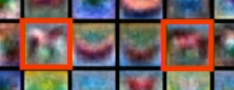

Is redudencies possible? Yes but can fix.

32. Deep NN. 

Depth - num of layers. 
Width - size of a layer.

33. Activation Functions.

This is $ max(..) $ and other. 

$ ReLU(z) = max(0, z) $ - rectified (выпрямленный) linear unit.

Q: What if no activation function? 
A: It will be just a linear classifier. No additional power beyon linear classifier.

Various exist:

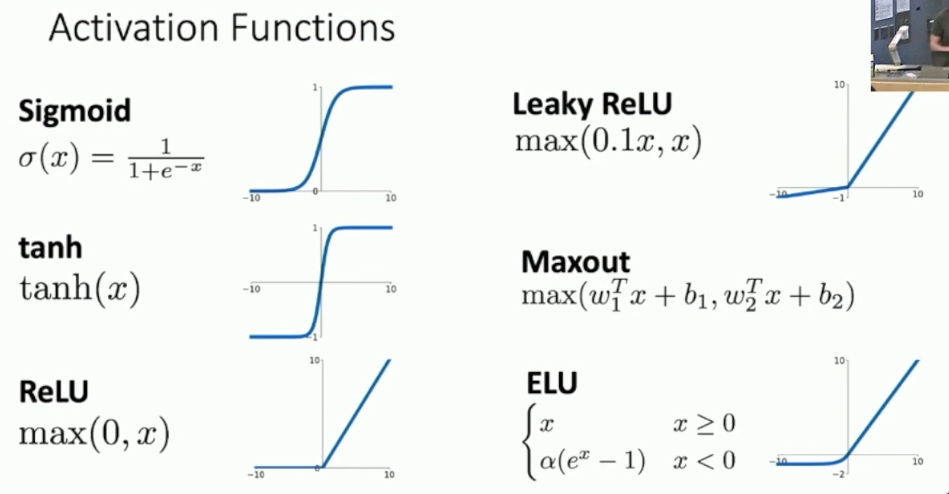

ReLU pretty good choice.

39. Simplest 1 hidden layer implementation example with numpy.

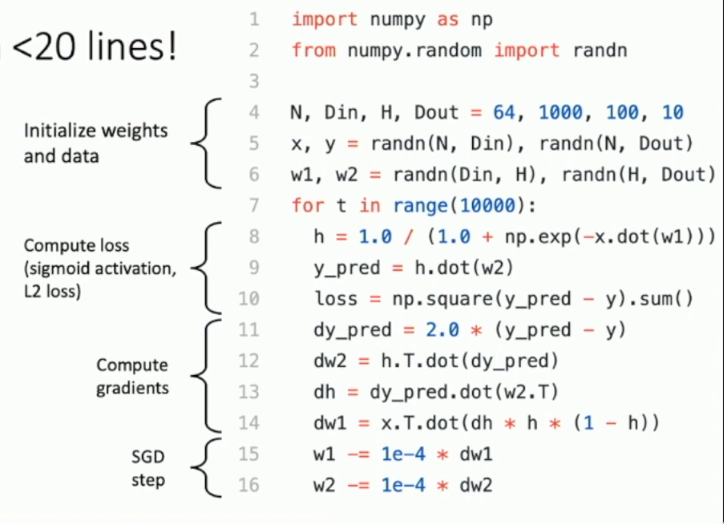

43. So what's neurons? Why this analogy?

Neuron:

- Cell body
- Axon - output
- Dendrite - input from other axon
- Synapse - connection between dendrites and axons. 
- Firing rate is at what point it fires outside when received an input rates. This is similar to artificial neurons. This is where simularity ends! 

There are many differences:

- can loop back to itself, they have very complex connectivity (topology). But artificial NN is in layers which is an abstraction.  There are research on complex topologies of NN. 
- Bio neurons are diff types
- Can perform non-linear computations
- Synapses are not single weight.
- Rate code might not be received.

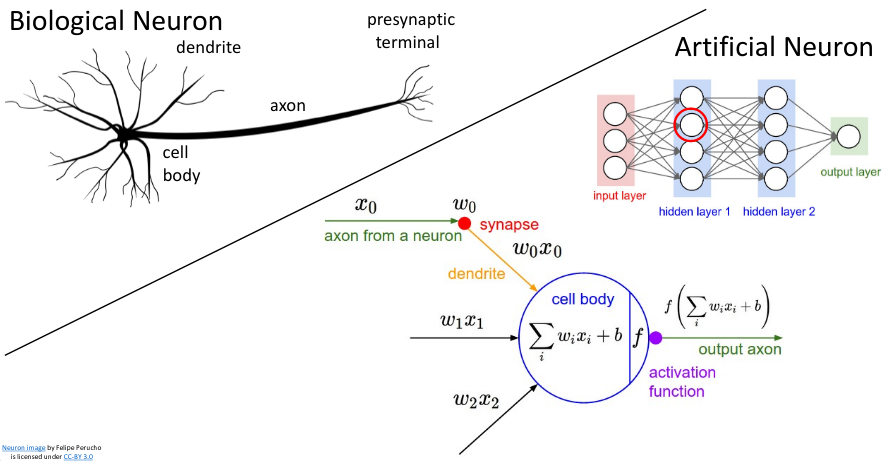

52. Space Warping.

Why NN so powerfull? Space warping. So for two classifies it can be viewed as it tranforms input into another 2-dimensional space:

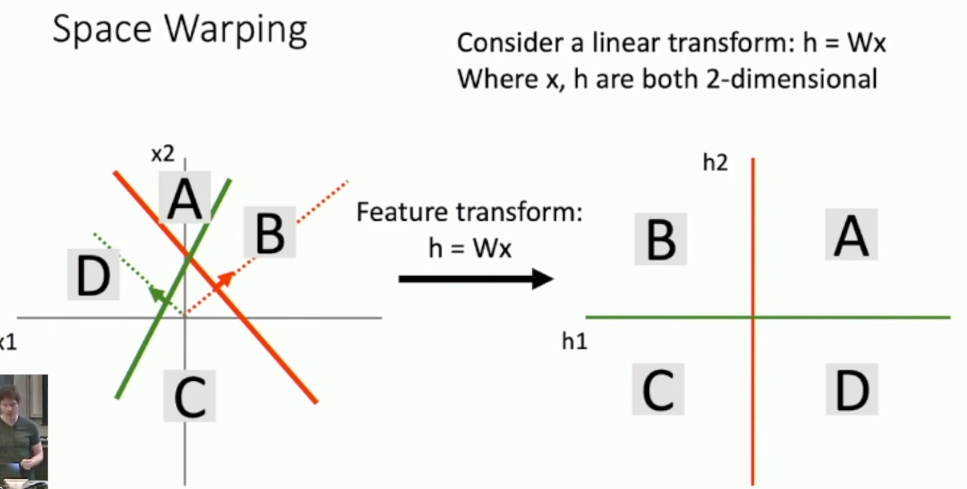

And so after one this transformation ( $ h = W x $) it only moves ones our features. And when we add activation function, eg. ReLU. It moves features to positive space via projecting them on positive parts of axes:

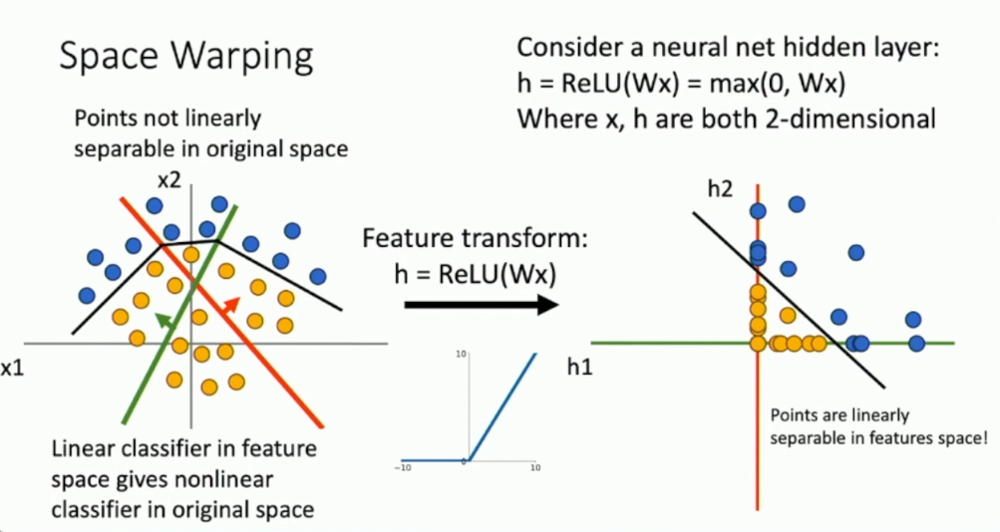

And it can be now linearly separated!

More complex for more dimensions. But we can increase num of hidden units so that it can find more complex patterns. 

So NN can be seen as transformers of the feature space. And they can represent very complex functions.

68. Universal Approximation.

A NN with 1 hidden can approximate any func, $ f: R^n \to R^n $ with arbitrary precision.

Intuition behind this U.A. theorem is that weights form many 'bumps' (шишки) that can be tuned such that it approximates any function.  

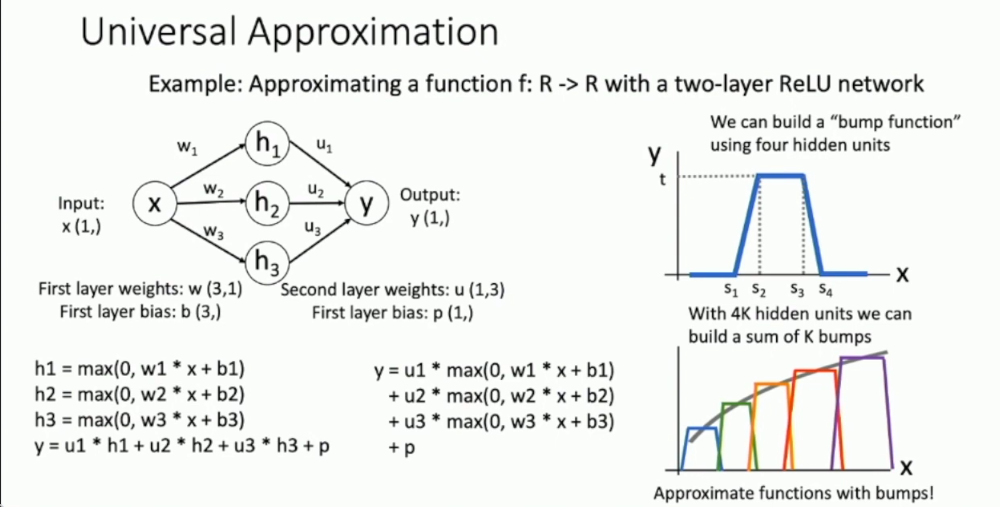

But what about gaps? other non-linearities? higher-dim? See Deep Learning book. (Nielsen, Ch 4)

This U.A. th. prooves in theory that it is possible. But in reallity it doesn't learn bumps. It doesn't guarantee that we will find such weights, or how much data. So it doesn't proove that NN is the best, silver bullet. Why? Remmber kNN is also a uni. approximator but very silly. 

How can we know that NN will converge?

85. Convergence. Convex functions.

Func is convex if $ \forall x_1, x_2 \in X, t \in [0, 1] : f(t x_1 + (1-t) x_2) \le t f(x_1) + (1-t) f(x_2) $ . Meaning a line connecting those two points always lies above.

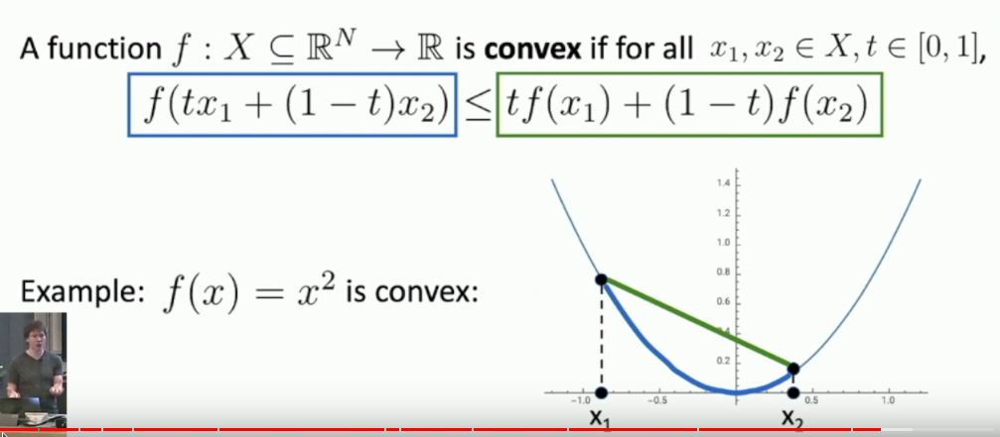

Contrast with $\cos()$ or $ \sin() $ funcs

They 1) easy to optimize; 2) converge to global min.

- 92. Linear classifiers optimization problems are a convex functions.

But no such guarantee for NN. Sometime they look like they convex but othertime they not:

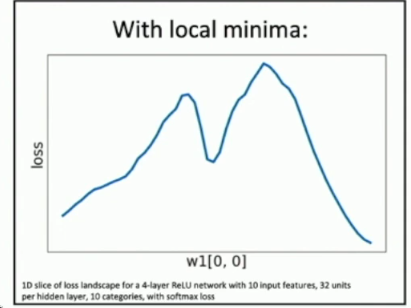

Most NN rely on nonconvex optimization. In practice it works (strange). Active area of research. 


102. How to compute gradients? Backpropogation.

### Questions

6. What's problem with linear classifiers?
7. Feature transformation. What's it? Name diff feature transformations.
8. NN. Basic form for 2 layers? With more layers? 

- What's in representation of NN an element (i, j) means in terms of source and target.
- How can we interpret those weights in NN?
- What's depth in deep NN? What's width?

33. Activation Functions. 
- What's it?
- ReLU func?
- Name other activation functions.

43. Neurons.
- Name main parts. What are they?
- Name differences with artificial neurons

52. Space warping.
- What's it? What's those $h$ represent?
- What happens with this wraping when we add activation func?
- What's NN then? 

68. Universal Approximation.
- Formulate the theorm.
- What's the intuition behind this? 'Bumps'?
- So any NN will work in practice? 

85. Convergence. 
- What's convex function? Formulate condition.
- Is Linear classifier a convex func?
- Is NN a convex func? What happens in practice?

## Lecture 6. Backpropagation


5. How to compute gradients? If we compute grad we can optimize the loss func. How for arbitrarity weights.

6. Naive. Derive gradient on paper. Idea is to write the derivative and then insert values. 
- Why this is bad?
    - Tedious. Long to write.
    - Not feasible for complex models. E.e. softmax.
    - Not modular design. If we have done for sigmoid loss but today want ReLU? Re-write then. So we want modular approach. 
    
Better idea is using computational graphs.

7. Computations graph.

Units are functions or variables that are combined with arithmentic operations. See picture:

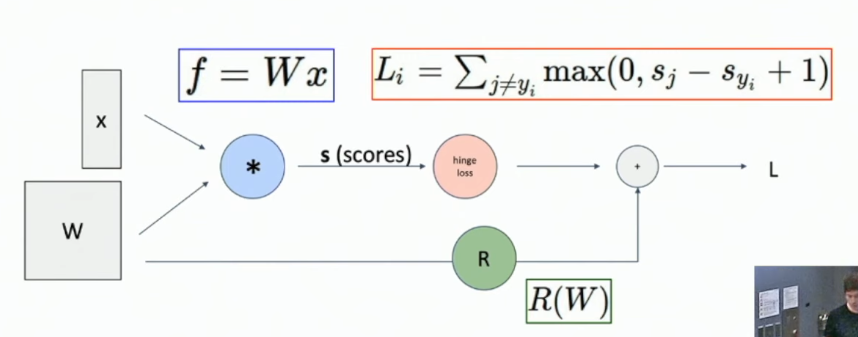

Seems trivial but if we take large deep nets then it's better to use those large graphs. Can be large! Consider Neural Turing Machine. And this can be even more complex when nets are recurrent. 

11. Example of how comp graph helps compute gradients.

- First step: Forward pass. 
- Second: Backward pass. Compute derivatives.

Question: what's derivative for $ f(x, y, z) = (x + y) z $ . Using backprog

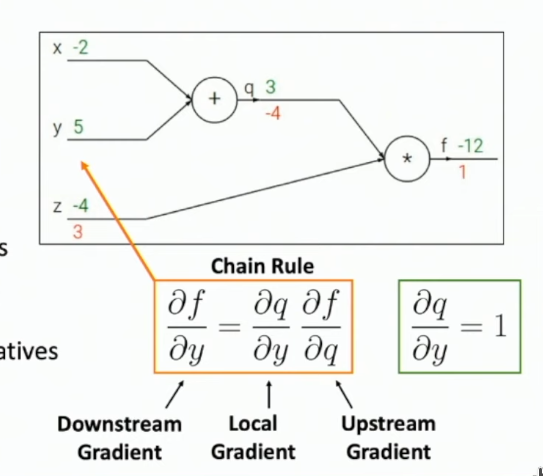

Terms:

- Downstream grad
- Local grad
- Upstream grad

Why good? Modular. Each piece doesn't need to know about other pieces. So a module (arithm operation) will have input and output. And derivative is calculated backward way. This is because of chain rule.

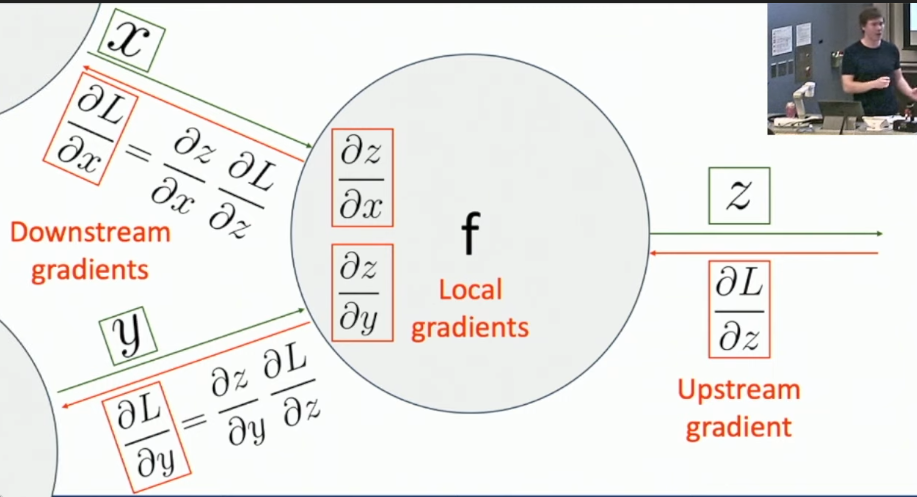

Adding arbitrary modules. So it breaks down into basic primitives. So let's define our functions to have shorter graph. E.g. let's add Sgimoid function. This is when one input and one output. 

46. Patterns in Gradient Flow.

- _add_ gate: gradient distributor. Two inputs and one output.
- _copy_ gate: gradient adder. One input, two outputes. Eg. when we want to use two copies: for regularization and for loss. 
- _multiplication_ gate: "swap multiplier". 
- _max_ gate: "router". Routes downstream only to the max flow and 0 to another.

50. How to implement in code?

"Flat" gradient code:

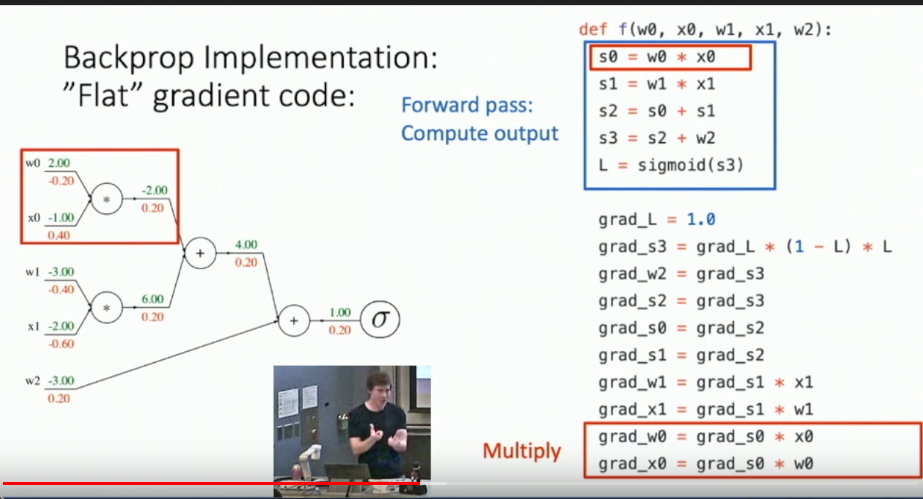

60. There is API for computing backprop. 

In PyTorch - autograd functions. It has a class for each operation that has `forward` and `backward`. 

67. What about vector-valued func?

1 varaible - Derivative.
n vector - Gradient.
n times m - Jacobian. 

The same picture for backprop with Vectors: downstream, upstream, etc.

75. Backprop with Vectors.

For $ max(0, x) $. Jacobian matrix is diagonal then. So never form explicit form of Jacobian. 

82. Backprop with Matrices (Tensor)

Upstream grad is matrix. 
Donwstream is matrix, tensors.

86. How to strategy to ease computations.

How to implement this? Strategy to ease it. It is hard because matrices are big. Consider 256GB for each matrix. And biggest GPU on market has less memory. How to compute without explicitely?

Think about one element and compute slices:

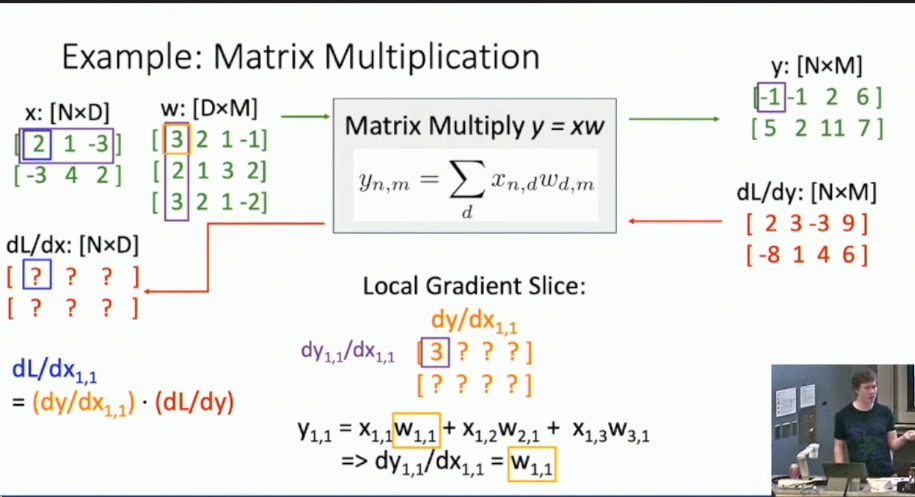

For example for multiplication this simplified into:

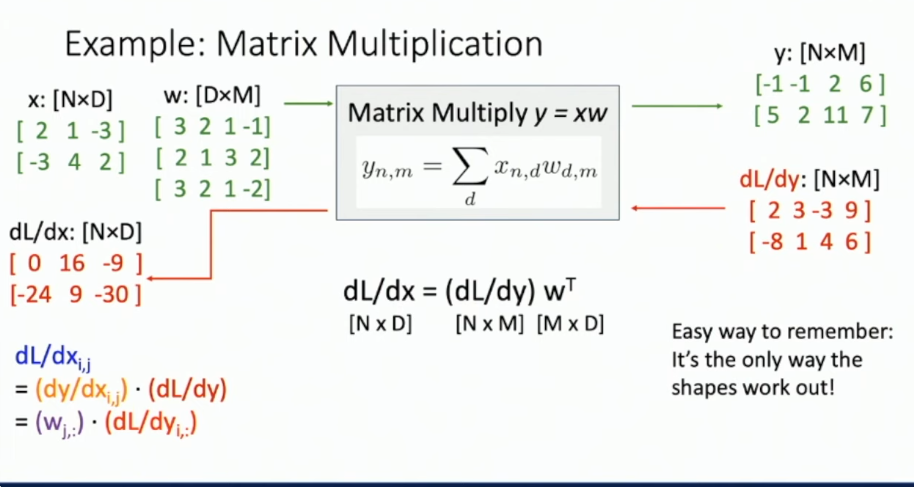

108. Another view on backprog

It's long chain of functions:

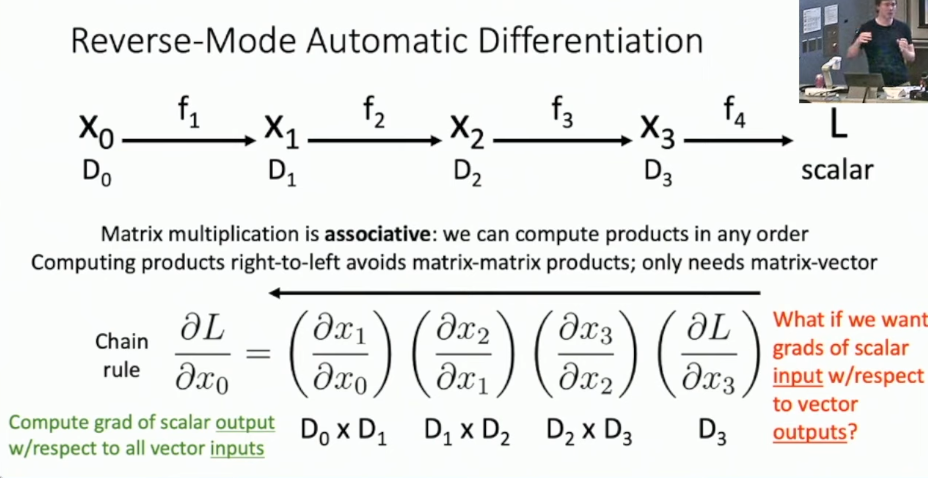

There is Forward-Mode Automatic Differentiation which is for diff w.r.t. a scalar. This not used in ML but might be useful elsewhere (physical simulations).

115. Higher-Order Derivatives.

The same backprop used. Hessian matrix - second-order. 
Tricks for multiplying Hessian by vector.
This is based on first-order derivatives. So we can compute higher-order derivaties. It is implemenhted in PyTorch/TensorFlow. 

122. Summary

So we have linear classifier, NN, backprop. But it doesn't respect the spatial structure of images. So let's go to Convolutional NN. 

Questions:

5. Why computing gradient 'on paper' and then using it in code is bad?
7. What is an alternative? Computational graph?
11. Backprop
- Show how to do backprop on $ f(x, y, z) = (x + y) z $. Where x=-2, y=5, z=-4.
- What's downstream/local/upstream gradients?
- Why it is good?
60. How is it implemented in PyTorch?
67. How to backprop with vector-valued functions?
75. With vector. If with vector, what type is Jacobian matrix then? 
85. With matrices. What's Jacobian matrix? 
- Computational problem with Jacobian matrices. How to simplify computation?
108. Another view on backprop? Chain of functions. 
115. Is it possible to compute higher-order derivatives with Pytorch/TensorFlow?
122. Why do we need Convolutional NN now when we have loss func, backprop, linear classifier, etc.? What do we lack now?


## Lecture 7: Convolutional NN

4. Recap. Backprop. Forward pass, backward pass, etc.

5. Problem now is that none of those classifiers (linear or NN) respect spatial structure. But it is very usefull to take into account spacial structure. 
- Solution? Define new operators (computational nodes) that operate one spatial input.

7. Components of a Con. Network.
- Fully-Connected Layers
- Convolutional Layers
- Activation Function 
- Pooling Layers
- Normalization

9. Convolution Layers

- It moves from Fully-Connected Layer. To recap: Fully Conn. layer takes flatten layer. And we multiply with $W$. 
- Now, Con. Layer preserve spatial structure. E.g. 3x32x32 image. 3 - depth or channel. 32x32 width and height. 
- Weight matrix now have also 3D structure. Now it is 'filter'. E.g. 3x5x5. 
- We will slide a filter to compute another 3D output.
- Filter depth should always match the depth of image. 

15. Computing. 

- Example. 3x32x32 image. 3x5x5 image. 
- Ouput of dot product is 1 number. This tells how this position on image matches with the filter. See image below:

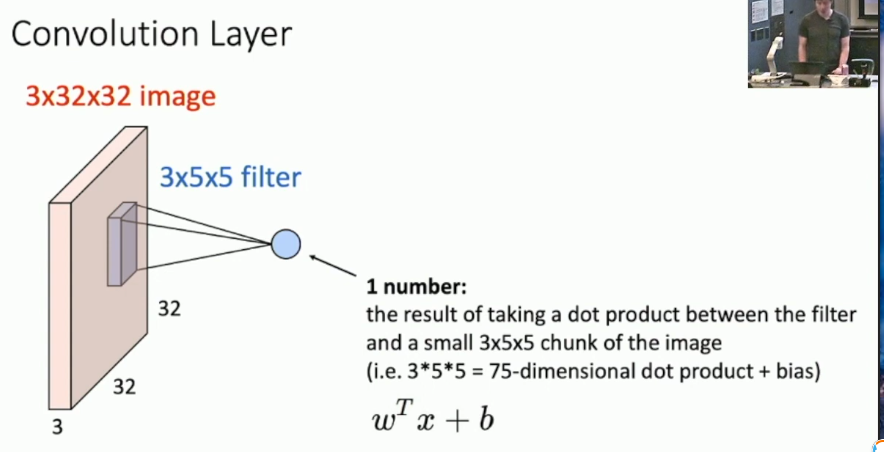

- After sliding over all spatial locations we get 'activation map': 1x28x28.
- We can do 2 more filters to consider all channels. RGB. Repeat two more times. 
- We can do more filters. Example below with 6 filters. And then we can stack 6 activation maps with each 1x28x28 to get into 6x28x28 output image. 

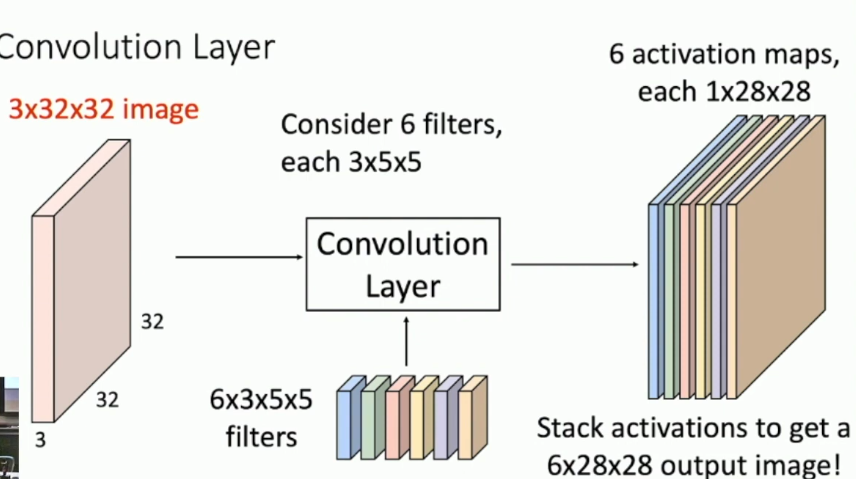

- Conv. layer always 6 dim bias vector. 
- What's output? Intuition. 
    1. A map that is output of a filter is how the image respond to this filter.
    2. A grid of feature vectors. Now take those layers together as a feature grid.

21. On batch of images. 

We can extend it to a batch of images. Each image gets its output. That is for N images it outputs N. 

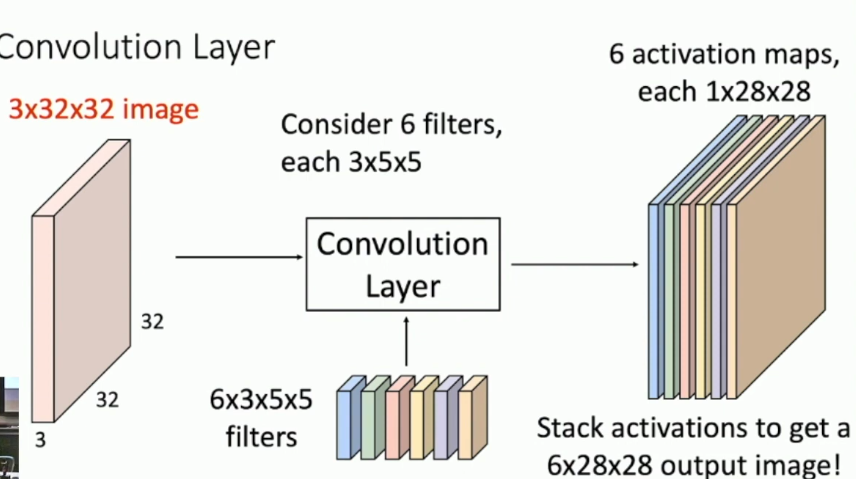

23. Stacking Convolutions. 

- Let's stack it and that way we get the layers of convolutions. 

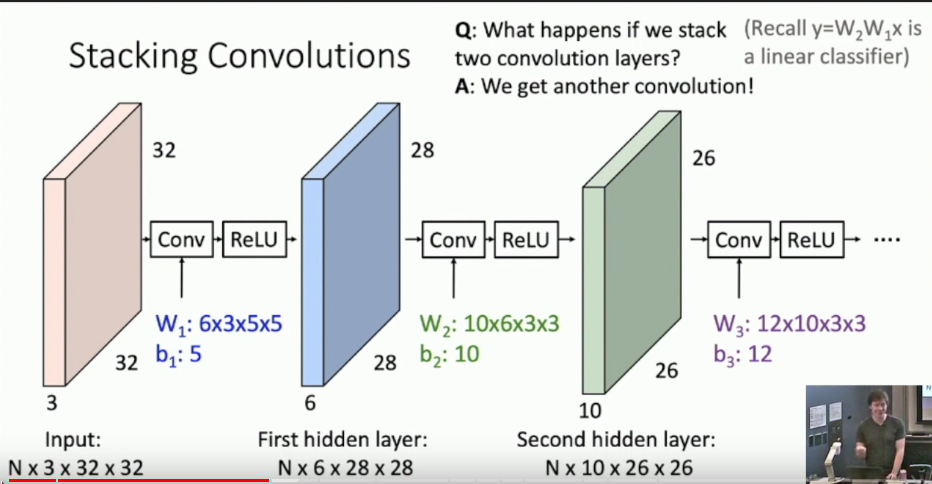

- Hidden layers is the same as before but now those are convolutions.
- What if we stack conv on another conv? We get third conv. So lets instert non linear activation function, let's add 'ReLU'. 

27. Interpreting layers. 

- We can visualize it the same way as before. Just view them as images. 

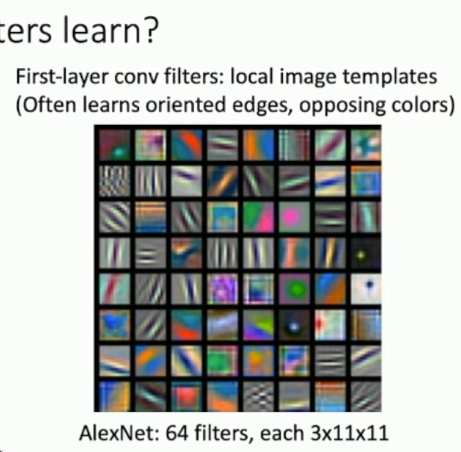

They might learn edges, frequences, opposing colors. 

30. Closer look at spatial dimensions.

- Input 7x7. Filter 3x3. Output: 5x5. So output: W - K + 1, where W -input, K - filter (kernel size). 
- Problem: it shrinks each layer.
- To fix we introduce, padding: add zeros around the input. So add $P = (K - 1) / 2$. 
- Receptive Field - is what a single element in output depends on.
- When several layers? Receptive fields are bigger. 

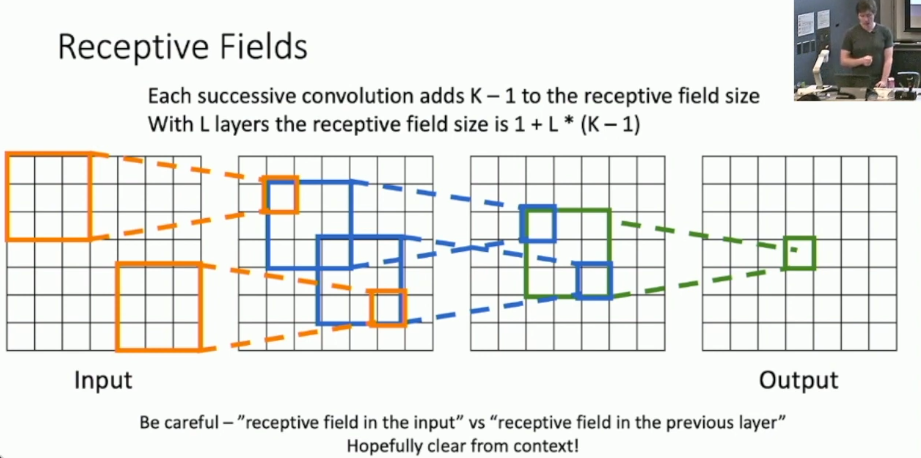

- Possible mix of terms: "receptive field in the input (image)" vs "in previous layer". The size is different.
- Problem: So how many layers we need for one unit to see whole image? Many layers then. Depends on the size.
    - Solution: Let's add another hyperparam. 'Stride' (шаг). Let's step not at every other but at every two or more (stride). Then it builds output quicker. Then it is $ (W - K + 2 P) / (S + 1)$ where W - input, K - filter, P - padding, S - stride.

- Question:

    Input volume: 3 x 32 x 32
    10 5x5 filters with stride 1, pad 2
    Output volume size:
    (32+2*2-5)/1+1 = 32 spatially, so
    10 x 32 x 32

53. 1x1 convolution layer. 

55. Recap. Convolution summary

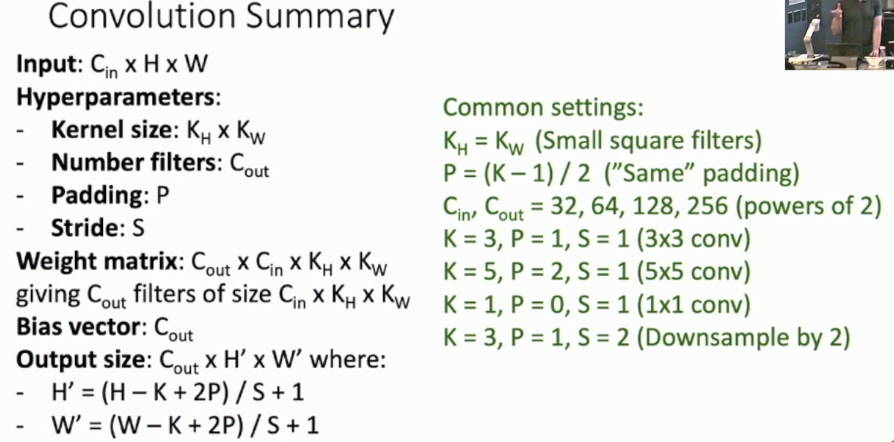

57. Types of convolutions

- 2D Convolutions. $C_{out} x C_{in} K x K $ shape.
- 1D Convolution. For text or audio. It is $ C_{out} x C_{in} x K $ shape.
- 3D Convolution. $ K x K x K $ shape. 

60. PyTorch Conv Layer

- `torch.nn.Conv2D`, `Conv1D`, `Conv3D`

63. Pooling layers (pool - объединять)

- Downsample or collapse without weights. It reduces shape (not rank). So for a particular set of values it reduces into one then repeats.
- Max Pooling. Stride and kernel size are the same. Max pooling is getting the max from those set of values. 

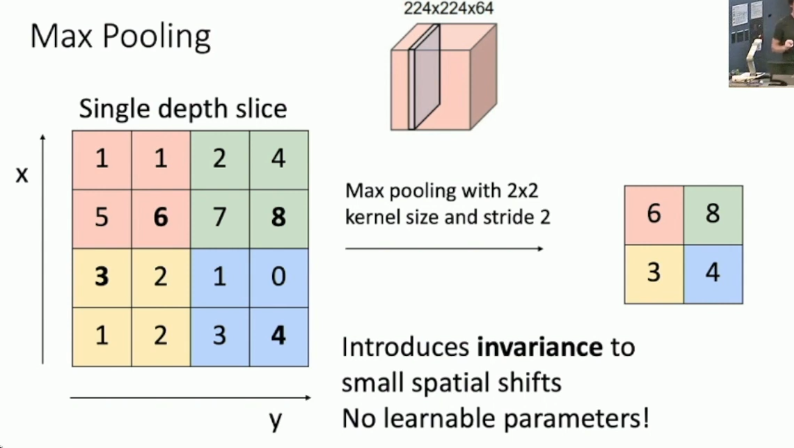

Why pooling? No weights. It introduces invariance, i.e max didn't change (somewhere useful).

Another is Avg Pooling. That is useing an average value for the set.

67. Architectures of ConvNets.

Many exist. Classic one is LeNet-5

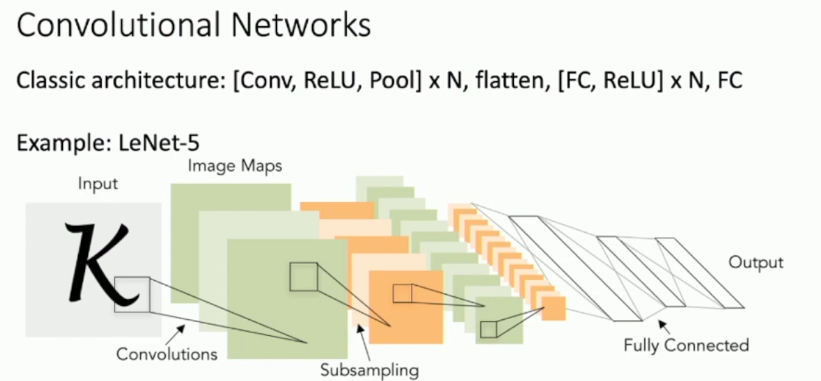

68. LeNet-5

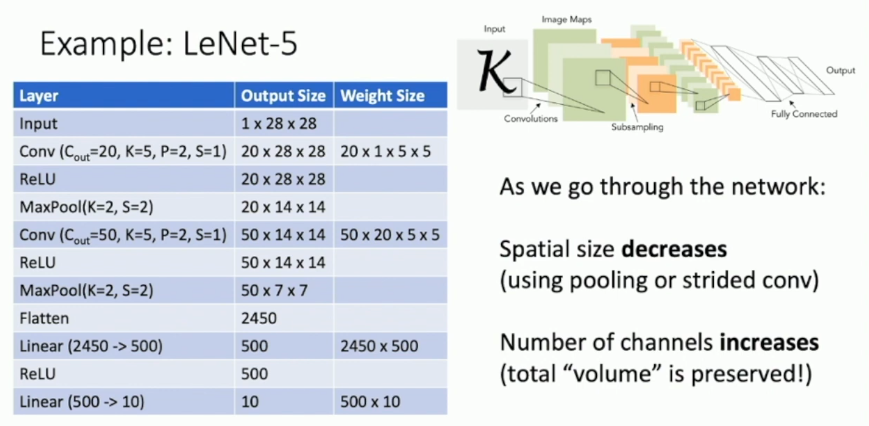

Total volume preserved with spatial size decreases but num of channels of increases.

77. Problem: Hard to train!

It's difficult to converge this NN. So let's add normalization.

79. Batch Normalization.

In Fully-Connected networks:

- Receive from prev layer, normalize it - zero mean and unit variance. 
- Why batch norm? "Internal covariate shift" improves optimization. See paper. In essence we want to avoid next layer to reflect prev layer noise (?). More stationary distribution. 
- It normalizes all layers, standardize them all:

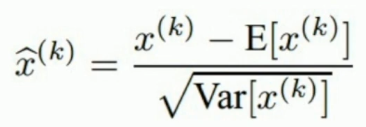

- So it will be another layer.

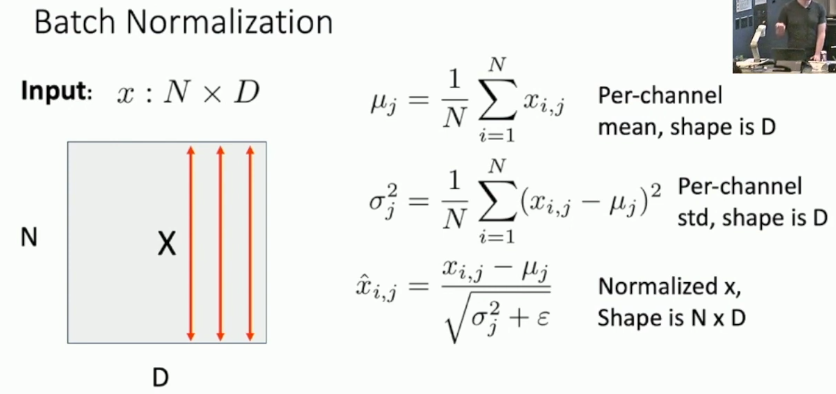

- Epsilon is to avoid div by zero.

- Problem is it might be hard constraint on NN when we make it zero mean. So let's do learnable scale and shift parameters: $ \gamma, \beta $. (TODO??)

- Problem: estimates depend on minibatch. (TODO?) For training it will keep running average mean / std. And at test time is different.

- 85. Batchnorm can be made a linear operator. So can be free at test-time. 

86. Batch norm In ConvNets.

Similar:

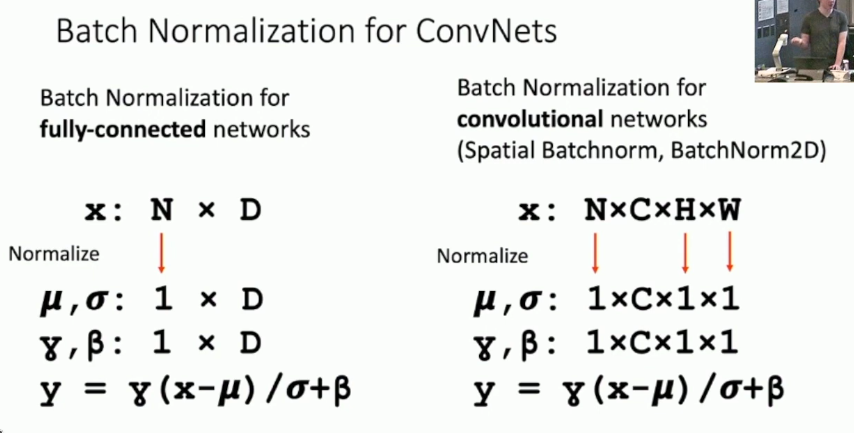

87. Batchnorm where to do?

Add after ConvNet layer or Fully-Connected layer. 

88. Batchnorm. Performance

Pros:

- Makes training must faster. So we can increase learning rate - this is robust finding.

Cons:

- Not clear why it helps. 
- Behaves differently during training and test time. Very common as source of bugs.

90. Layer Normlization. 

- To fix the issue with diff behavior at test and train time.
- Simular to Batch norm. It computes avg over D dimension (not over examples but over dimensions of those examples). Then be

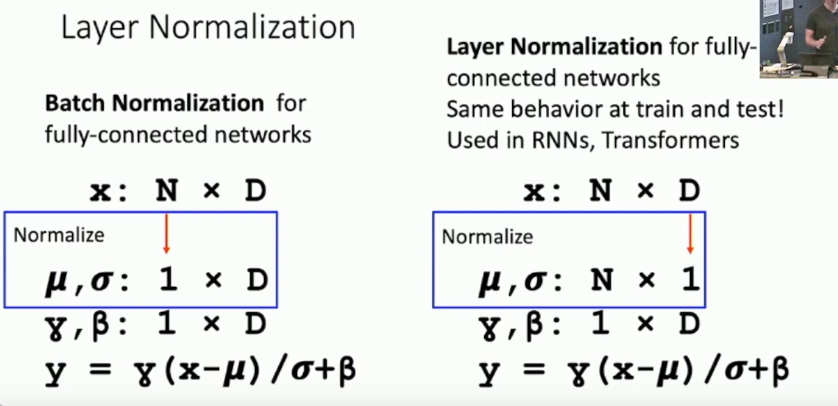

91. Instance Normalization

- Simular Layer Norm but now on diff dimensions:

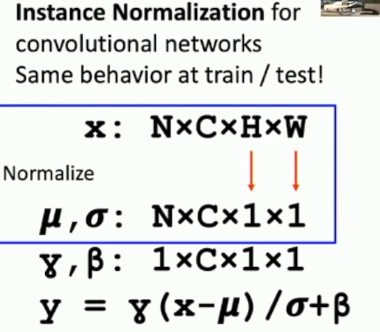

92. Comparision of normalization

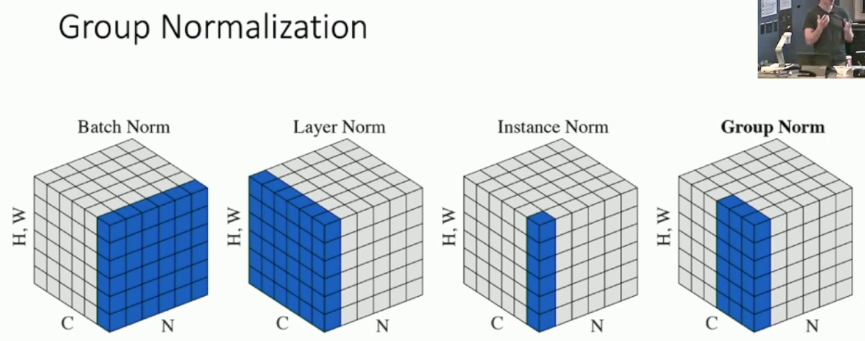

94. How to combine? This is a next lecture. 

### Questions:

5. What's problem with linear classifier and NN? What's solution?
7. Name components of Conv. NN.

Convolutional layer:

9. Conv. layers
- What's filter?
- How large can be filter? Its depth?
- What's value of a cell in output?
- How many filters there are typically?
- What's intuition behind the output? Two ways of thinking about output.
21. How do we do it on a batch of images.
23. How do we stack convolutions? What's the problem if we stack directly?
27. How can we visualize layers?
31. Example. How large output for this example: Input 7x7. Filter 3x3.
- What's the shrinkage? Is it problem? How to fix?
39. What's 'receptive field'?
- Why might we need many layers if we consider one item in output and its receptive field? Is it problem? Solution?
- What's stride? How output size now calculated?
47. Example. Calculate: 
    Input volume: 3 x 32 x 32
    10 3x5x5 filters with stride 1, pad 2
    Output volume size: ?
57. What types of convolutions there are? 

Pooling layer:

63. Pooling layer.
- What it does? Difference from convol. layer.
- Why pooling?
- What's Max Pooling? How implemented? 
- What's Avg Pooling?

67. Example of ConvNet: LeNet-5. How many convol. layers? What is the last layer?

Batch Normalization:

77. Problem with ConvNets
79. How normalization is done?
- Describe how to compute it.
- What's $ \gamma , \beta $ params?
- Can we make it into a linear operator?
- Performance of batch norm
90. Other types of normalization:
- Layer Normalization
- Instance Normalization
- Group Normalization

## Lecture 8. CNN Architectures

4. Last Time: Components of CNN: conv. layers, pooling layers, fully-connected layers, act func, normalization. 
- But how to combine? So let's see history

5. ImageNet Class. Challenges
- Error Rate benchmark.
- From 2010. At 2010, Lin et al - 28.2% with Shallow (linear class.)
- 2012 - AlexNet.

7. AlexNet
- 227x227. 5 Conv. layers. Max pool 3 fully connected layers. ReLU .
- Used "Local response norm". Not used now.
- Trained on _two_ GPUs. GTX k80 GPUs with 3GB of memory each.
- In the picture (see below) we see it is split into two GPUs.

- AlexNet was very cited: 46.5 K citations! Compare with Darwin - 50K citations. Shannon - 69K. So it is not good metric. So AlexNet looks like a historica mark in human knowledge.

- 12. Structure of AlexNet

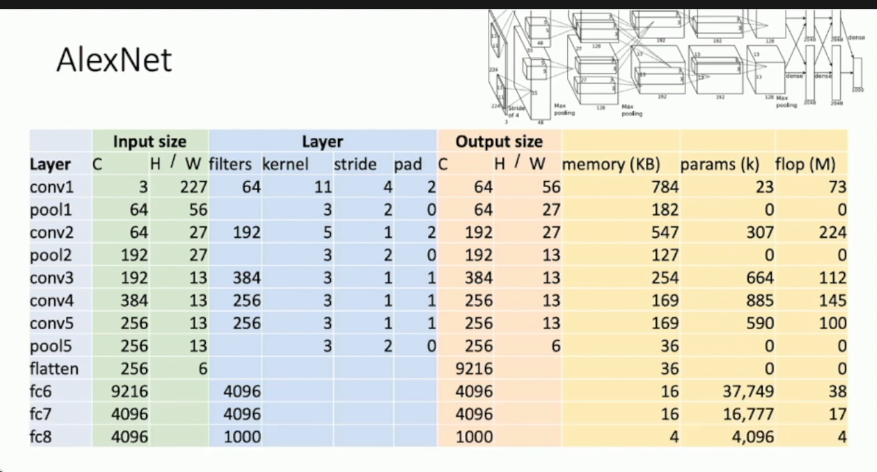

- How it was designed? Trial and error. 
- But if we check memory, params, flop then:
    - Most memory usage and FLOP in conv. layers.
    - Most parameters in fully-connected layers
- The above is very common.
- Computation was split into two architechtures. 

33. In 2013 ZFNet. 8 layers net. Based on AlexNet.

- They tweaked AlexNet. Bigger version of AlexNet. Same 8 layers.
- Top 5 error now: from 16.4% to 11.7%.
- Bigger nets work better!


37. VGG architecture. 2014

- Had principles in design: 
    - All conv are 3x3 stride 1 pad 1
        Why? 
            - Option 1. Conv(5x5, C -> C). Params: 25C^2, FLOPs: 25C^2HW
            - Option 2. Conv(3x3, C -> C). Params: 18C^2. FLOPs: 18C^2HW.
                And same receptive field.
            So no reason to make filter bigger. So make kernel size always 3x3.
    - All max pool 2x2 stride 2.
      And after bool double # channels.
      - Why? 
    - 5 conv stages. VGG-19 - 4 conv in 4 and 5. 
- AlexNet vs VGG-16
    - VGG-16 is much bigger, it dwarfs AlexNet.
    1.9 MB vs 48 MB. 61M vs 138. 0.7 GFLOP vs 13.6 GFLOP.

46. GoogLeNet. 2014

- Aim: minimize cost of training.
- Used aggressive stemming network: to downsample input: 

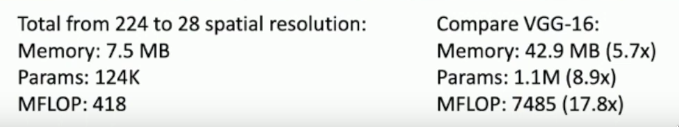

- Inception Module. 

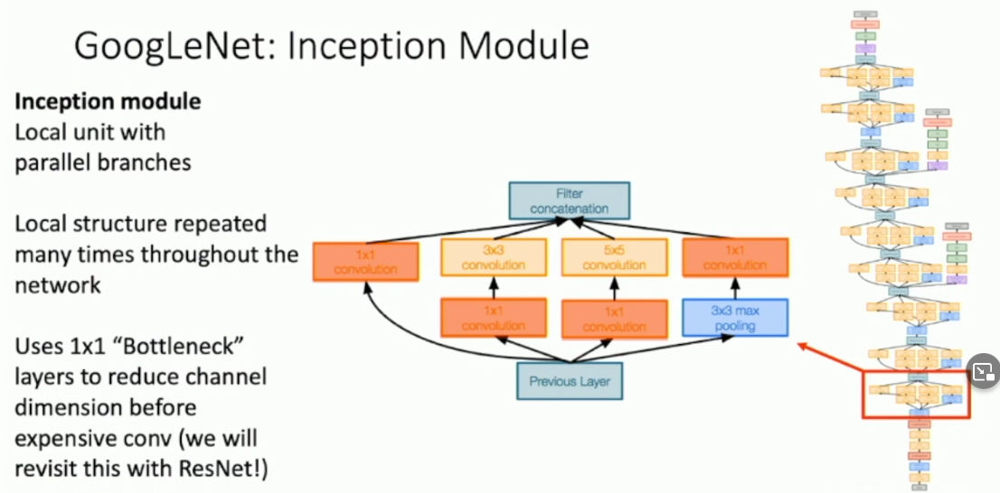

- Global Average Pooling. This is instead of fully-connected layer. And in the end only one fully-connected layer. This was repeated by others.

- Auxiliary Classifiers. It was before batch norm. This is ugly hack. 

58. 2015 year. 152 layers. With Backnorm. This is Residual Networks come (residual - остаточный).

- What happers if we add layers? Go deeper? It does worse than shallow model. 
- Is it overfitting? - they thought. But on a training error it was the same picture, it was worse. So it is not overfitting, but underfitting. Something happen with optimizaiton. THis is also suprising because a deeper model can emulate a shallower model: copy layers. They should do at least as good as shallow.
- Why? Hypothesis: it is optimization problem.
- Solution: change the network so learning identity functions with extra layers is easy. This is to avoid degradation in the case of simple models. So they can emulate shallow models when they don't need many layers.
    - Residual block:
    
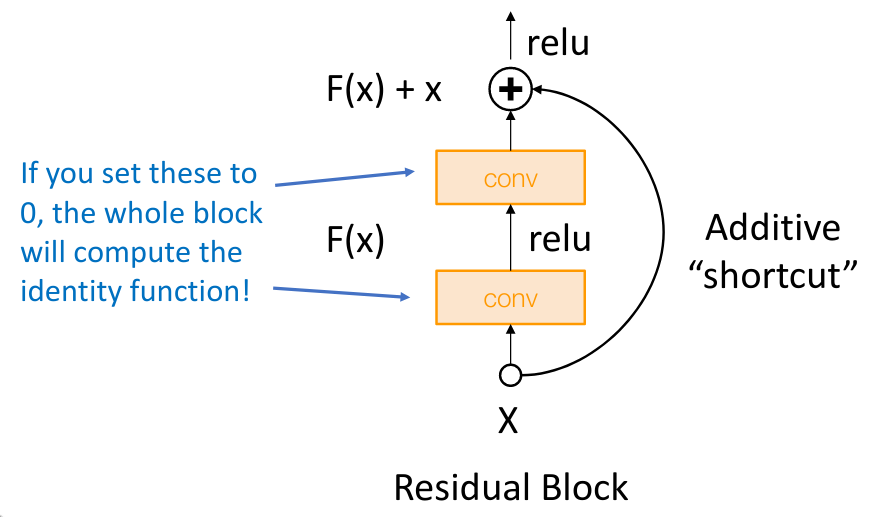

66. Residual Networks.

Is a stack of many residual blocks. It takes innovations from VGG (3x3 conv) and GoogLeNet (stemming in beggining and global avg pooling in the end). So now we only choose num of layers:

- ResNet-18. 1 conv layer, 4 stacks of 4 layers with residual blocks and conv, and linear at the end.
     - ImageNet top5 error: 10.92%

- ResNet-34. Top5 error: 8.58%

72. Residual net: diff designs of the block

- "Basic"
- "Bottleneck"

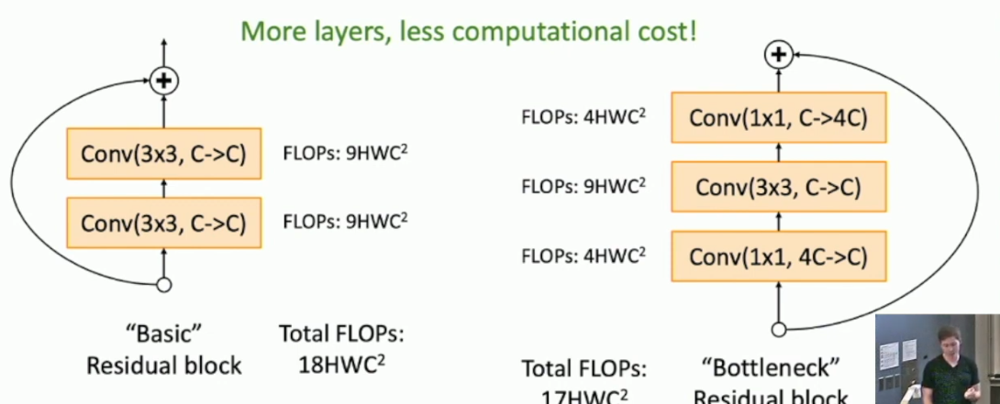

Slightly less FLOPs but more non linearity which is assumed to be better.

- ResNet-50 uses the "Bottleneck" block and do more layers but we simular num of computation. 

- Clear trend was that making it deeper it performce better.

- So in 2015 Residual Networks took all prices so it prevails now.


82. Comparing Complexity.

This picture shows that designing networks allowed to get better accuracty with less memory and compute.

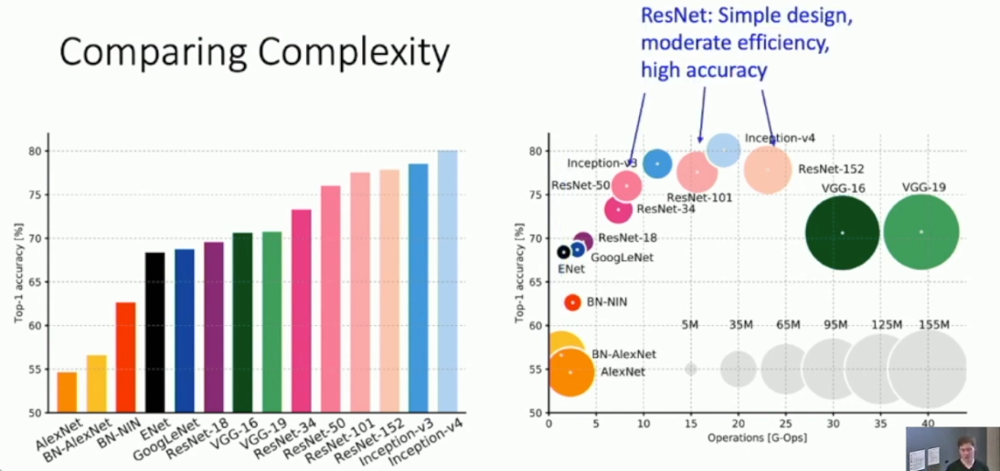

90. In 2016, ImageNet winner didn't have new ideas implemented but was an ensembles of all previous work. And did slightly better.

91. Improving ResNets: ResNeXt.

- Let's do parallel blocks. 

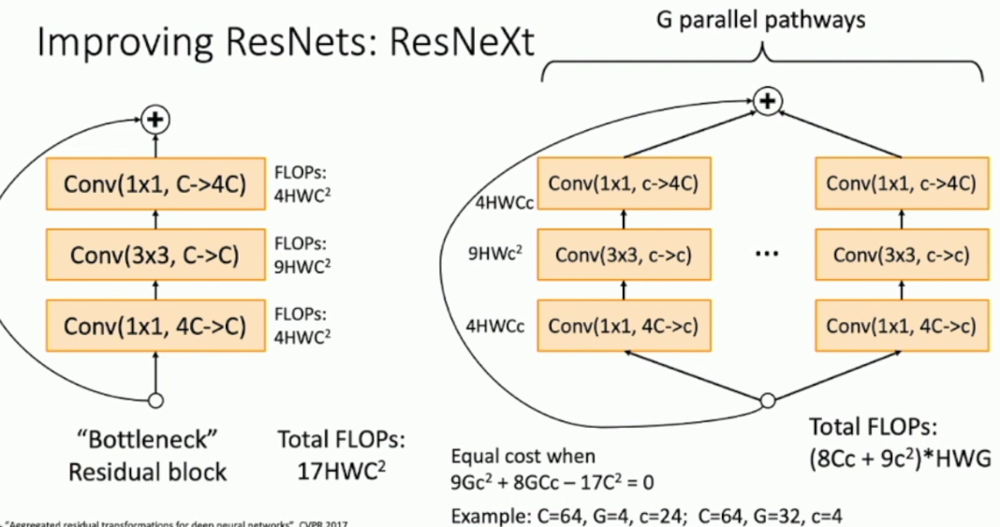

- Same computation but more parallel pathways. 
- In PyTorch - group parameter.
- And adding more of those pathways (groups) it increases accuracy but with the same amount of compute.

104. ImageNet closes on 2017 

105. Densely Connected Neural Networks

- Instead of adding previous features with later features, it concats them.

106. MobileNets.

- Aim: min computation. For mobile devices. 
- See ShuffleNet, MobileNetV2.

108. Automating designing neural arch.

- Automates this process. A controller outpus network architectures.
- But it is very expensive.
- It can be used to find efficient CNN arch. 

111. Summary.

112. What to use?
- ResNet-50 or ResNet-101. 
- Or MobileNets or ShuffleNets for mobile devices.

### Questions:

4. Problem with CNN? 
5. What's ImageNet?
7. AlexNet.
- Its parameters: num of layers, how many GPUs.
- How it was designed?
33. ZFNet, 2013. Num of layers. 
37. VGG, 2014. 
- Its principles (rules) of design.
- 3x3 stride. Why?
- Comparing VGG with AlexNet
46. GoogLeNet. 2014
- Its aim.
- Aggressive stemming. How?
- Global Average Pooling
58. 2015. Residual Networks.
- Problem with deeper networks that time?
- Hypothesis why this?
- Design of Residual block.
- What advantages it gives?
72. Types of Residual block
- Basic
- Bottleneck
91. ResNeXt. Parallel pathways. New residual block.
105. Densely Connected NN.
- Concatination
106. Mobile devices NN.
108. Automating NN architecture search.



## Lecture 9. Hardware and software

4. CNN arch - we have. How it runs?
6. Hardware
- CPU. 
- GPU. GeForce GTX. Takes more physical space.
    - Nvidia vs AMD. Inside ML it is only Nvidia because of software.
11. Historical power. GigaFLOPs per Dollar. It shows that flops per dollar for GPU. But for CPU it stays the same almost. From 2006. 
12. More CPU vs GPU. Cores for GPU - 4608! CPU - 12. Clock speed: 4.7 vs 1.77. 
13. RTX Titan. It is a minicomputer inside. 12x2 GB memory. SMs - streaming multiprocessors (simular to traditional CPU cores). 16.3 TFLOP/sec. Tensor core inside hardard itself - it does tensor multiply (for ML specifically). 
- What we give up? We lose precision. 32 floating point arithmetic. With tensor cores it is ~132 TFLOPs/sec.
- Example: matrix multiplication. It fits perfectly for GPU. 
26. Programming GPU
- CUDA - C-like code.
- No need to write CUDE. Use Nvidia API.
27. Scale up. Use more GPUs. 
28. Gooogle vs Nvidea. It is TPU - Google Tensor Processing Units. 
- It is a secret how they work. 180 TFLOPs. Can buy but can use on Google Colab. 
- Cloud TPU v2. It has 11.5 TFLOPs for hundreds of dollars. Other options.
- But u need to use TensorFlow. 
- Gaming GPU vs ML GPU. Need more memory for ML. Also the speed of memory.
34. DL Software.
- A zoo of frameworks. PyTorch (from Torch). TensorFlow (from Theano). CNTK (MS). JAX (Google). MXNet (Amazon). 
- Why DL frameworks?
    - Rapid prototyping
    - Gradients
    - Runs on GPU (TPU)
39. PyTorch.
- 1.2 version used at the course. 
- Concepts:
    - Tensor. Numpy array like. But on GPU. 
    - Autograd. Computational graphs.
    - Module. NN layer.
- 43. 
- Tensor. `torch.tensor`
- Autograd. `requires_grad=True`, `.backward()`, `torch.no_grad()`, `.grad`, `.grad.zero_()`. There are a lot of functions (sigmoid, etc.) inside. And can define new ones (`torch.autograd.Function`).

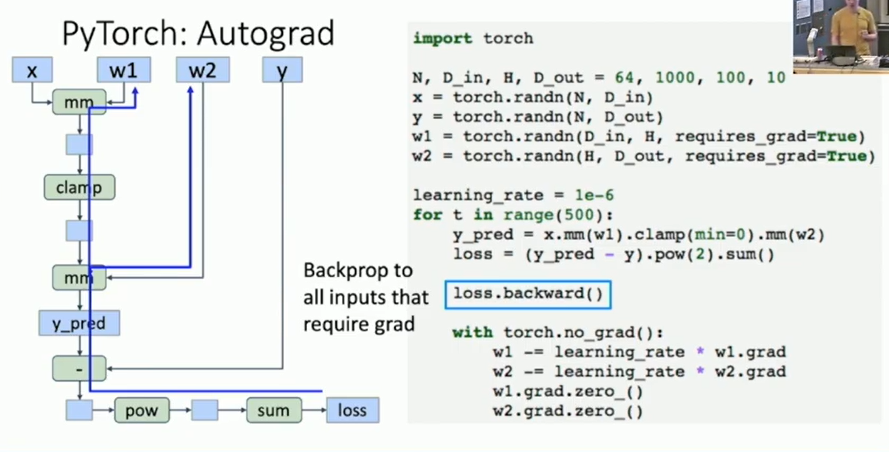

- 70. nn module. For neural networks.
- `nn.Sequential` for layers. 
- `optim.Adam` for stepping.
- 78. Custom modules for NN. `torch.nn.Module`. Can putting there our layers.  And then can use them to construct larger NN. 
- 84. DataLoaders. To load data.
- Pretrained Models. github.com\pytorch\vision
- Problem how to reuse graph?

- 93. Dynamic Comp Graphs. Optimization not to drop comp graphs. 
- Static Comp Graph. Alternative to dynamic. `torch.jit.script`. Compiles a graph. 
- Static vs Dynamic: optimization. 
- Static - can serialize and deploy. Dynamic - need code. 
- Static downside is hard to debug. 
- Dynamic Graph applications: Recurrent Networks. Recursive networks. Modular Networks.

113. TensorFlow.
- By default static graphs on 1.0 version. But on 2.0 default is dynamic graphs.
- TensorBoard - statistic for your model (also for Pytorch)

133. TensorFlow vs PyTorch.
- PyTorch:
    - clearer API
    - can't TPU
    - Not easy for mobile devices
- TensorFlow
    - Can be confusing. Api messy

### Questions

- GPU vs CPU
- What's TPU?
- Software. TensorFlow. PyTorch.
- PyTorch. How to create tensor? How to autograd? How to make NN? What's DataLoaders?
- TensorFlow. 

## Lecture 10. Training NN - 1

5. What to know before actually train NN?
- One time setup. Activation func, etc.
- Training dynamics. Optimization, scalling out / up.
- After training. Model ensembles, transfer learning.

7. Activation functions (AF)
- Act. func. are critical.
- 9. Zoo of AF

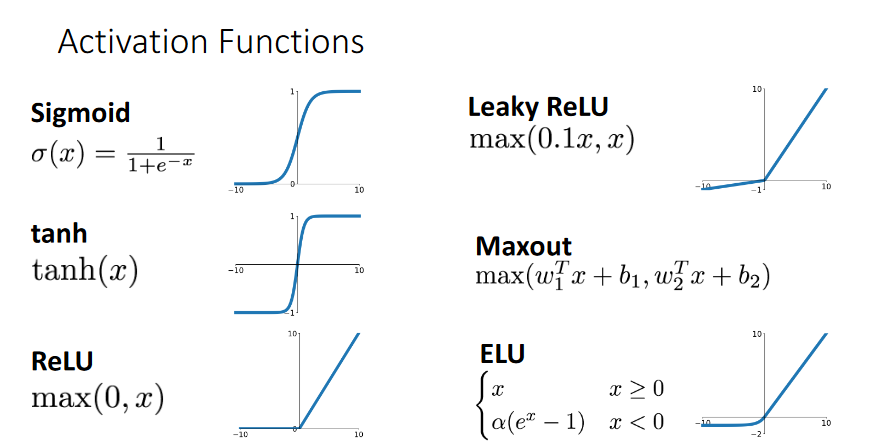

10. Sigmoid AF
- Pros: probability, firing rate of neuron.
- Cons: 
    1. Saturated neurons 'kill' gradients. Diff to train NN then. If x = -10 or 10 then close to 1 or 0. So downstream values become very low or close to 1. So no signal to other neurons. Learning dies.
    2. Outputs not zero-centered. What if input always positive? What w then? All gradients are either positive or negative. Why problem? But we want to take positive _and_ negative steps: consider if our convergence point is at bottom right for two weights w1 and w2. And it becomes worse in more dimensions, it is exponensially worse. This might work for minibatches (for single example it is problem).
    3. exp() function. It is expensive function. Not problemn for GPU. But it is for mobile devices.
    
20. Tanh.
- It is scaled and shifted sigmoid. 
- Pros:
    - zero centered
- Cons:
    - Still kills gradients
    
21. ReLU
- Pros:
    - Won't saturate
    - Computationally efficient
    - Converges much faster (up to 6 time as in AlexNet)
- Cons:
    - Not zero-centered. Less of a concern as it is faster.
    - If gradient < 0, then downstream gradience are zero. So again kills learning for that. This is called 'dead ReLU' - some examples will never activate. There is a trick to avoid dead ReLU is init weights with slightly positive biases (0.01).
    
27. Leaky ReLU.
- $ max(0.01 x , x) $
- Pros:
    - Solves cons in ReLU. 
    - Doesn't saturate. No killed neurons
    - Comp efficient
    - Converges
- Cons:
    - Extra hyperparameter.
    
28. Parametric Rectifier
- Learns they extra param from Leaky ReLU: $ max (\lambda x, x) $
- Cons:
    - The issue those ReLU are not diffirenciable at 0. Practically not important.

29. Exponential Linear Unit (ELU).
- if x > 0 then x, otherwise $ \lambda(exp(x) -1) $
- Pros:
    - All for ReLU. 
- Cons:
    - Again exp()

30. SELU 
- Rescaled ELU. That uses special scalars. Allows to train deep NN. Why? See 91 pages of math in the paper.

32. In practice
- Diff AF doesn't matter much. See diagraph. Within 1% with each other. 
- Don't stress too much. Don't use Sigmoid or tanh. Use ReLU will probably work


34. Data Preprocessing

- Idea: before feeding data we transforming it
- Data Cloud far from center. 
- For numerical: Pull to origin: mean. Scale : div by std.
- Why? The same logic as for loss func: to make gradients both neg and pos.
- For non-numeric or non-image data. 
    - Decorrelation - move to origin and rotate so that they are not correlated
    - Whitened data. First decorrelation and then apply normaliz (mean, std). 
    - See PCA and whitenend.
- Why helpful? THink about where linear classifier will be. If near origin then easier to find the classifier. If far from origin, then a little change the more classification change.

- 40. For Images. 
    - Subtract mean. AlexNet
    - Subtract per-channel mean. VGG
    - Sbutract per chan mean and div by std. ResNet.
    - When compute statistic? Only at training time. At test time, in the wild it is not computed.
    - If Batch Norm then data preproc? Should work but better explicitely.

42. Weight initialization
- If W=0 and b=0. Then it is bad because all outputs will be zero and gradients also. Problem - 'not having symmetry breaking'. 
- In practice: let's do small random num. $ W = 0.01 * np.random.randn(Din, Dout) $. Works for shallow but not for deep.
- 46. Activation Statistics for deep networks. 
    - 47. Plots for learning when random - how gradients look like. Standard deviation decreases, collapses towards zero. So no zero if deep NN. 
    - How to fix? Let's init with a larger values. From 0.01 to 0.05 scalar. Again they all in saturated regime, local gradient is zero.
    - Solution? Xavier initialization:
    
    $ W = rand (Din, Dout) / sqrt(Di) $
    
    For conv layers, Di is kernel_size^2 * input_channels. 
    Xavier assumes _zero centered_ (but ReLU is not).
    
    - How to derive? 
    
    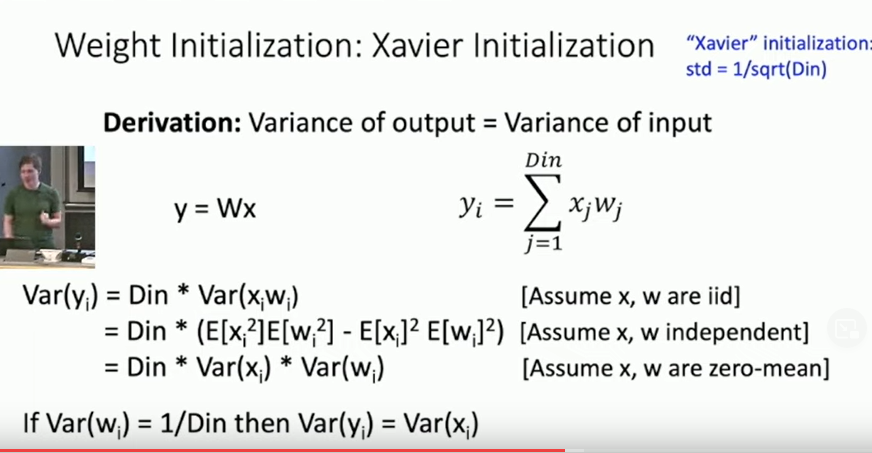

    - But we have ReLU. Then what? Plot of gradients again show that no learning. It collapsing. Need to change init. 
        Kaiming / MSRA Initialization. 
        - And MSRA could converge without batch norm.
- 63. For residual nets? Now MSRA doesn't work as gradients grow and grow and blows. 
    Solution: Do MSRA for first conv layer but for secon conv init weights to zero. Then Var(F(x) + x) = Var(x)l.
- This is active area of research. Basicaly we want to have good gradients.

66. Regularization. 
- Problem: overfitting.
- Ways: L2 regularization, L1, etc.

- 68. Dropout. Randomly set some neurons to zero. Probability - 0.5 common param. 
    - Why? It prevents co-adaptation of features or it prevents redundant representation. So diff neurons specialize. 
        - Dropout trains ensemble of NN hence many NN and the final will sum them.
    - Implementation: multiply output by mask that sets some output values to zero (0.5 probability). 
    - Problem: test time then random! Ouput is random. Consistency between deployment.
        We want to average out our randomness. 
        
        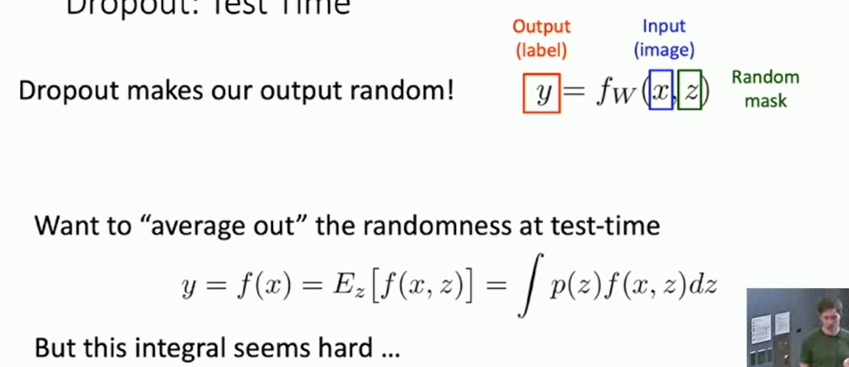
        
    - How to compu integral? No idea. Then we approximate it. Compute $ E[a] $ during training. 
    
        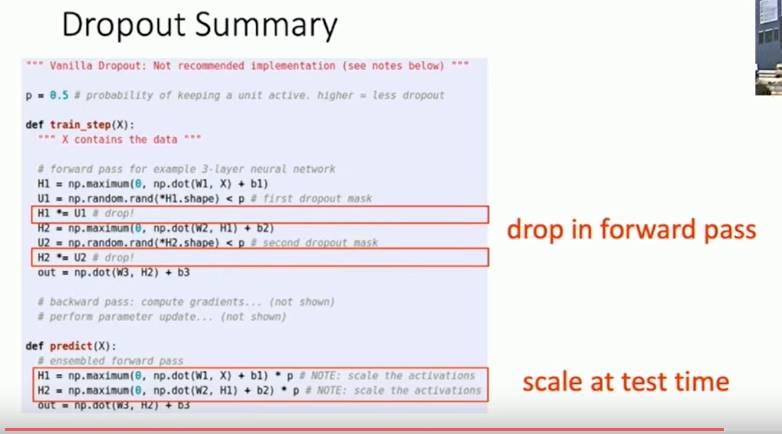
        
- Another: 'Inverted dropout'. Diff is when we do scaling at test or training time.

- 80. Where to insert Dropout? Architectures.
    - At the end. In fully-connected layers. 
    - But for later architectures (resnet, etc.) they use global average pooling instead of dropout.
- Dropout is simular to Batch Normalization as it adds randomness at training time. Output of is dependant where an output was, in what batch. So for ResNet L2 and Batch Norm replaced dropout, this is the only regularizing.


85. Data Augmentation.
- Modify data to get more data, randomness.
    - Crop
    - Scales
    - Resizing
    - Rotation
    - Translation
- This multiplies dataset, more input.
- But this depends on data. COnsider left and right hand. Human knowledge applies.

Other regularizations:

- 92. DropConnect. Drop connects. Similar to dropout but drops (zero) weights.
- 94. Fractional max Pooling. Randomize sizes of the pooling regions in conv NN. Some 1 by 1 others 3 by 3, etc. 
- 95. Stochastic Depth. Skip some residual blocks in ResNet. 
- 96. Stochastic Depth. Cutout. Cut some area from input. 
- 97. Mixup. Blend images with random blend rand. 

What to use?
- Dropout for large fully-connected layers
- Batch norm and data augment - always good idea
- Try cutout and mixup.

### Questions

5. What we need additionally know before actual training?
7. Activation functions. They pros and cons:
    10. Sigmoid
    20. Tanh
    21. ReLU
    27. Leaky ReLU
    28. Parametric Rectifier
    29. ELU. 
    30. SELU
    32. What to use in practice?
34. Data preprocessing
    - What's it? 
    - For numerical. How? Formula
    - Why works?
    40. For non-numeric, non-image. 
        Decorrelation.
        Whitened
42. Weight initialization
    - What if W=0 and b=0? 
    - How to init for shallow NN?
    - How to init for deep NN? Xavier init. 
        - How? What's problem then? (ReLU)
    - Kaiming MSRA init
66. Regularization. 
    - Ways? L1, L2.
    68. Dropout. How to implement? Why it works?
       - What's problem with dropout? How to fix it?
        80. Where to insert dropout? 
        - Do we need Dropout if we have Batch normalization and L2 regul in ResNet.
85. Data Augmentation.
    - What ways?
    - Can we always apply data augmentation?
92 Name other ways to regularize?
- What to use?
        


## Lecture 11: Training NN. Part 2

Training dynamics: learning rate, hyperparams.
After training: model ensembles, transfer learning, batch training.

13. Learning rate. 

Probably most important.

Variants:

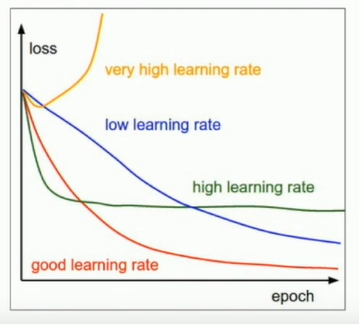

Good is quick to low loss, steadily, not exploid to infinitty.
Best? No one is the best. But change it over training. If platauing then change to lower, etc.

Learning rate schedule:

- "Step" learning rate decay. At few fixed points reduce learning rate. Then it looks like a ladder. "Step learning schedule". 
    Cons: introduces a lot of new hyperparameters. It takes a lot of trial and error. It is complex.
- "Cosine" learning rate decay. Again reduce but use cosine func: $ 1/2 * a_0 (1 + cos(t \pi / T )) $
    Popular somewhat.
    Pros: no new params. T and a_0 we have. T - num of epochs.
    Cons: it is one of many shapes.
- "Linear" rate decay. Just use linear: $ a_t = a_0 (1 - t / T ) $
- "Inverse sqrt": $ a_t = a_0 / \sqrt(t) $. Cons: spends much time in lowrates.
- "Constant": $ a_t = a_0 $ . He recommends it. Behaves reasonably well. Optimize later (to get 1-2% extra percentages).
    
Questions:
- about exploiding loss. See data for bad examples.
- Choose learning rate by hand? Can but hard. Avoid.
- Plot moving average of loss. Gives hint on long-term 


18. Early stopping.

Monitor - accuracy for train and val; and monitor loss. Always good idea. Check every 5,10, .. epoch. Stop on a point where val starts to degrade.

22. How to choose parameters?

- Grid Search. Choose several values for each. Space them in log-linearly. For each param. Evaluate all possible choices on this grid. 
- Random Search. Log-uniform on some interval. Run many diff trials. Choise the one set that works best. There is strong argument for choosing random - (Random Search for hyper-parameter optimization, 2012, paper). We got more samples?

In real world. 
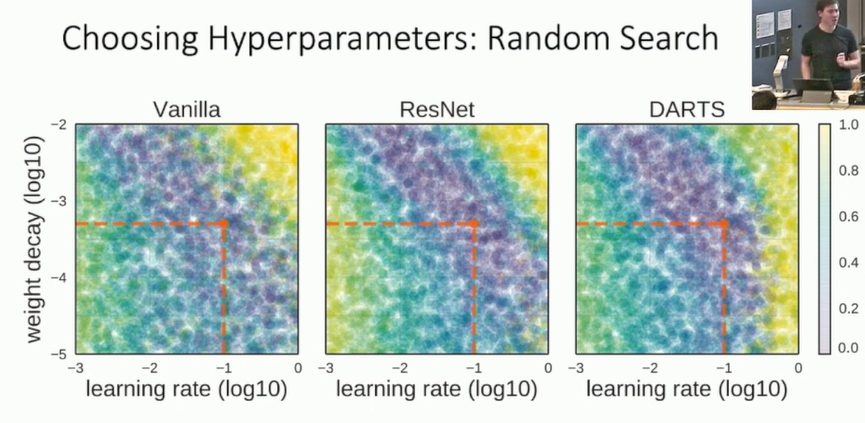
Dark purple works well other worse.

Can use Gradient Descent to find hyperparams? Yes. Active area of research. There are above and below ML models then. But not used in practice as comp is expensive.

How to choose if no tons of compute:

1. Step 1. Check init loss. Turn off weight decay. What your expected loss (analytically)? then check it. E.g. for Cross-entropy loss - -log(C)
2. Overfit small sample. Train to 100% accuracy within 5 min or so. To find out I have no bugs. Don't care about regularizaiton, etc.
3. Find learning rate that makes loss go down. Within 100 iters or so. Good: 1e-1, 1e-2, 1e-3, 1e-4. Now we see loss starts to go down.
4. Coarse hyperparams grid. For ~1-5 epochs. And check from a set of params around those you found in prev step.
5. Refine grid, train longer. Best from previous and longer train.
6. Look at learning Curves. 
7. Goto step 5. 

Situations:

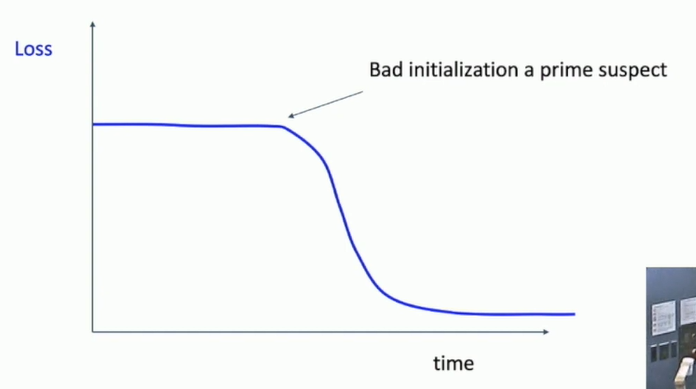
Bad init

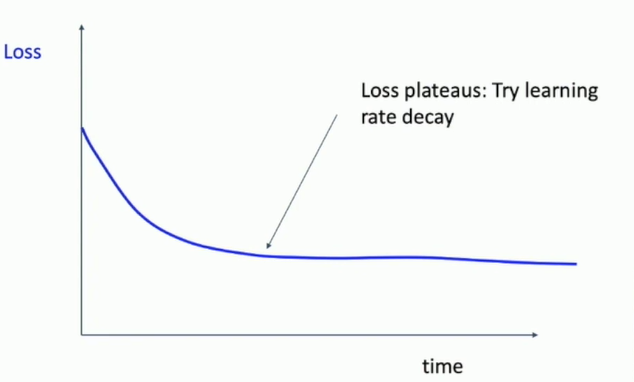

And other.. See lecture.

Also look at accuracy for train and val:

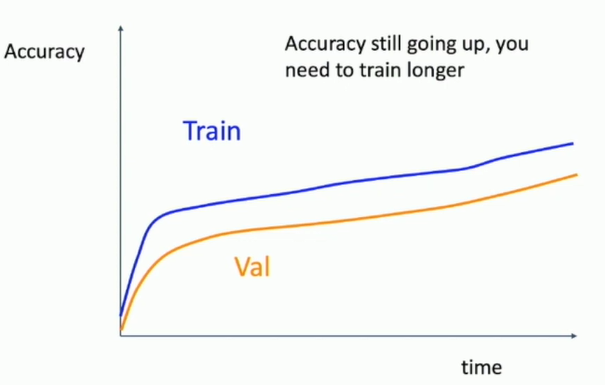
The above is good. continue to wait.

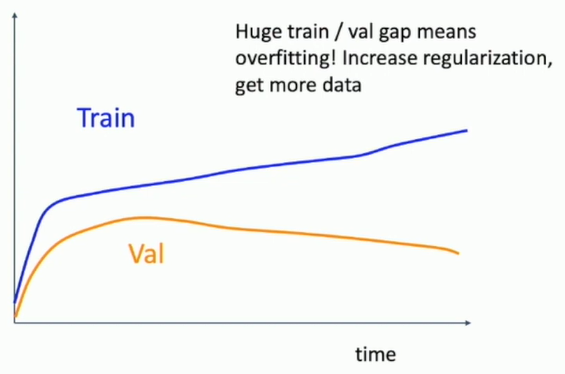
This one is bad as it overfits.

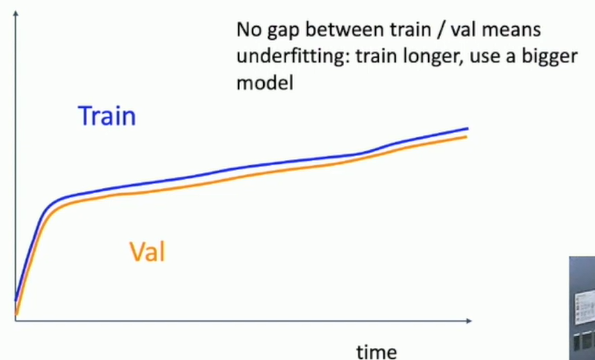
This is underfitting. Better with larger gap. 

All this looks like DJ doing music. You need "command center" for cross-validation. Use TensorBoard (should work with PyTorch).

Other things to track: ratio of weight update / weight magnitude. About 0.01 is ok.

45. After training

46. Model Ensembles. 

1. Train multiple independent models
2. Average their results. Averaging tech varies.

Tips and Tricks:
- Use multiple snapshots of a single model to get ensembles.
- Keep a moving average of the parameter vector. And then use those averages at test time:
    $ x_test = 0.995*x_test + 0.005*x $  where $ x $ is current weights.
    
49. Transfer learning. 

Need a lot of data? No, it's false. Use transfer learning.

T.l. with CNNs:

First, train on ImageNet.
Second, freeze some layers (this feature representation).

Used widely. Examples:
- Classification on Caltech-101: LogReg DeCAF6 w/ Dropout, other.  
- Bird Classification. 
- Other image classifications. They first pretrained on ImageNet and then used it for new dataset.
- For image retrieval (find similar picture). Using nearest-neighbour on top of transfer learning. 

- 58. Find-Tuning. For large datasets. Take pre-trained model (example is on imagenet), throw the last layer and reinit this last layer and continue training all model for a new dataset.
    - Gives good results. 
    
- 61. Architecture matters. Good is ImageNet, many researches use it.
    - Works good on ImageNet then better on other datasets.
    
- 64. How to approach transfer learning with CNN

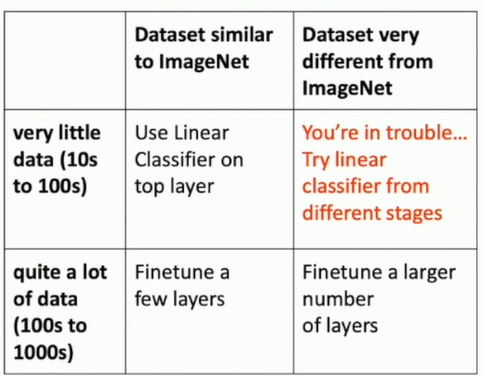

Transfer learning is a norm not exception. 

Also some research transfer from more than one datasets.

Cons of transfer learnings:
- Can do well without transfer on some datasets.
- Can do better without transfer. 


74. Distributed Training. 

Using many GPUs. Splitting model along diff GPUs.
- Bad split model vertically. They will wait.
- Better horizontaccly. Bad also as need to sync.
- Better use batches of N images with separate models. At end of each pass: exchange grads, etc. Can split on hundreds of GPUs. Even can do splitting on diff data centers.
- Large-Batch Training. Scaling Learning rates linearly through those GPUS.
    - Learning Rate Warmup.


#### Questions:

13. Learning rate.
- What's good learning rate?
- What learning rate decay to use?
18. Early stopping. 
- What to monitor?
22. How to choose parameters? What's the best method?
- Algorithm to find better params if no tons of compute?
45. Model ensembles.
49. Transfer learning
- Variants.
- Fine-Tuning
74. Distributed Training. How to train on many GPUs?

## Lecutre 12. Recurrent Neural Networks (RNN)

7. Intro

So far it was "feedforward" NN. One to one. 

Other:
- "One to many". Image into image description.
- "Many to one". E.g. video to a label. 
- Many to many. E.g. machine translation, Eng to French. Seq to sequence problem.
    - Per-frame video classification: sequance of images -> lables. Commentator on a video. For each.

To work with sequences as input or output we use some kind of RNN. We want to process seq of arbirtrary length. 

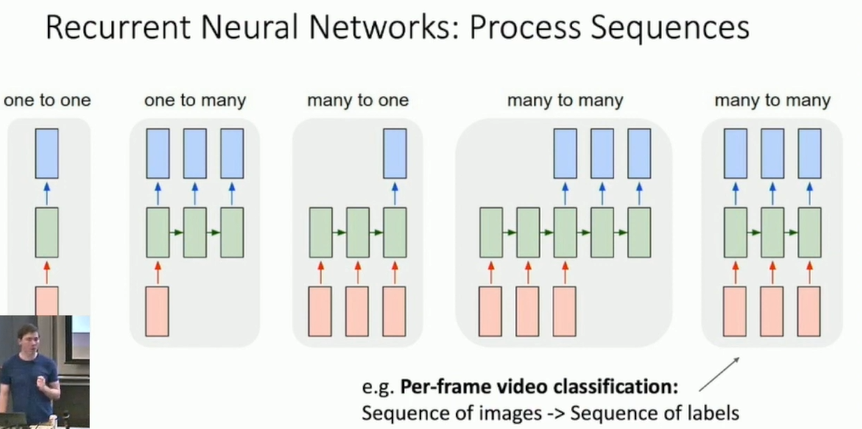

12. Seq proc of non-sequential data. 
Take multiple glimpses of image. And then classify an image. And after some glimses it makes prediciton. 
Another: generating images. Generate an image one piece at a time. Examples: generated digits; painting images of faces. 

15. What's RNN?

Key idea: is processing a sequence and also RNNs has internal state that is updated as seq processed.

$ h_t = f_W (h_{t-1}, x_t) $

Process x by applying recurrence formula. $ W $ - learnable weights. $ h $ state. $ x $ input. Single weight matrix at every step of a sequence. And the same function $f$ at every step. 

18. Vanilla RNN (aka Elman RNN in owner of Prof. Jeffrey Elman)

$ h_t = tanh (W_{hh} h_{t-1} + W_{x h} x_t) $ - gives current state.
To get output: $ y_t = W_{h y} h_t $ 

Where $ h $ single vector, and three $ W $ matrices for $ h_{t-1} $, for $ x_t $ and for $ h_t $. 

- 19. Example.

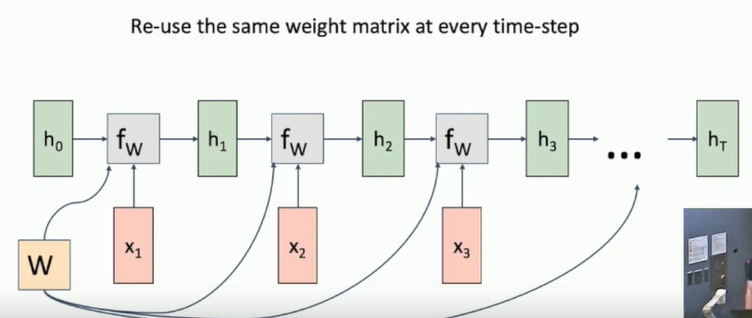

No matter how many $ T $ there, how long the sequence. 

And we can use it for our types problems:

For many to many:

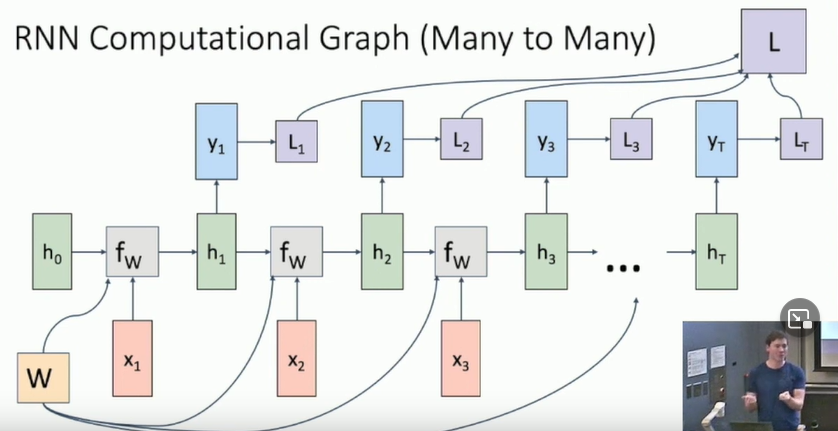

E.g. video classification per-frame. And it produces $ y_i $ and then we can apply $ L_i $ if we have labels (supervised). And the final $ L $ loss will sum those $ L_i $ . 

Many to one then only one $ y $ at the end. E.g. single label for a video. Note it depends on entire sequence.

One to many. Also can use RNN. At beginning a single $ x $.

28. Sequence to sequnce (seq2seq). (Many to one) + (one to many). Another type of problem. E.g. to translate Eng to French.
How to implement? From one NN (many to one) (encoder) and then into another NN (one to many) (decoder).

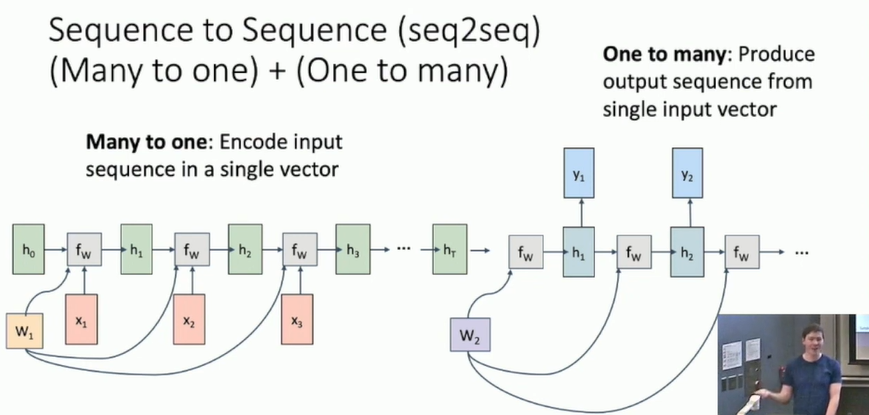

Why? Because we don't know how long sequence.

Example. Language Modeling. Given chars what's the next char? Infinite seq of chars and every time it tries to predict next char.

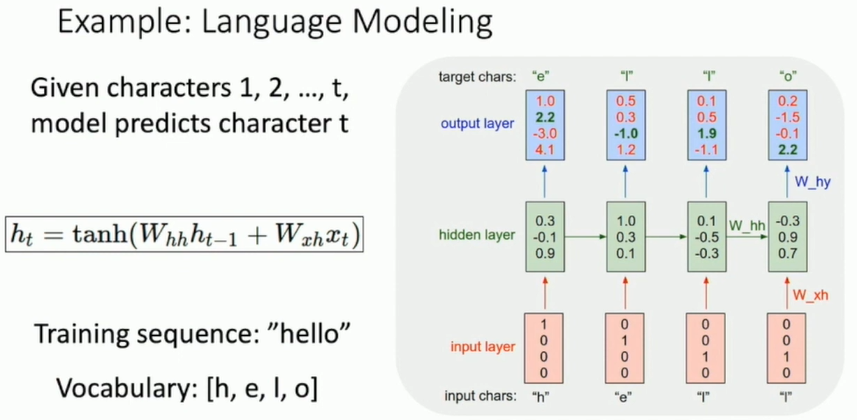

Generating text. But we can generate text from this after we trained the NN. Example: given 'h' it outputs 'e'. Then we feed this 'e' into NN again, it outputs 'l' and so on. We keep internal weights ( $ W_hh $ ) and internal state $ h_i $.

Optimization: that is one-hot-vector at beginning so extract this into a separate layer (embedding layer).

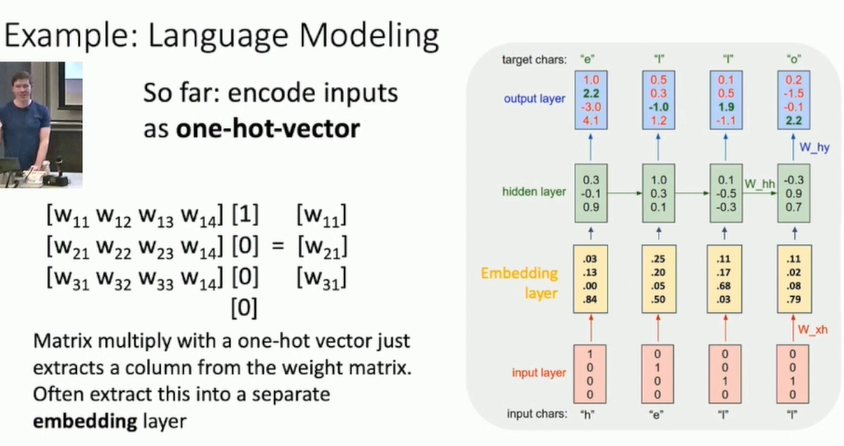


44. How to train. Backpropagation through time. 

Problem: need a lot of memory if large graph for those sequences. 
In practice we truncate those sequences: take subset of sequence. Compute loss then backprop. For the next chunk of seq. Backprop only to the beginning of the chunk. Then forward does infinite seq but backprop does only for chunk. Can be done in 112 lines on Python (not pytorch). 

Examples.
1) William Shakespeare. The sonnets. No sense. 
2) Latex algebra geometry. No sense.
3) Linux kernel source code. 

63. Visualization. Why it succeeds in learning structure for those so well? What does these language model RNN learn? 

Methodology. In the process of training it colors a next char using prediction from one cell, that prediction is from $ tanh \in [-1, 1] $ where blue is close to -1 and red close to 1. Hence we can get idea what this cell looking for. 

Example. Quote selection cell:

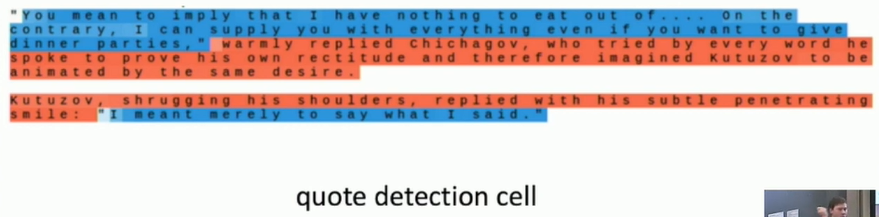

Other examples: inside a comment, length of line, indentation, etc.

70. Example: Image Captioning

That is use CNN with RNN. 

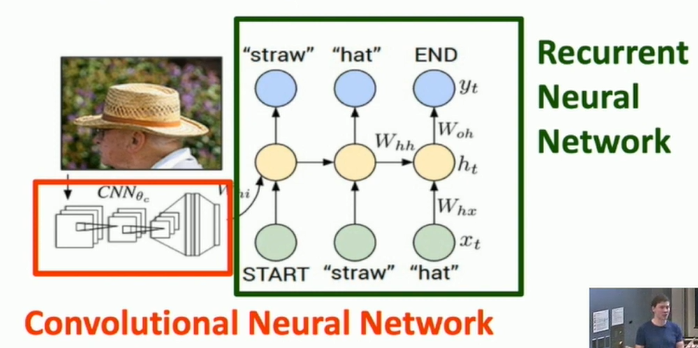

Uses transfer learning. It modifies recurrence formula. 

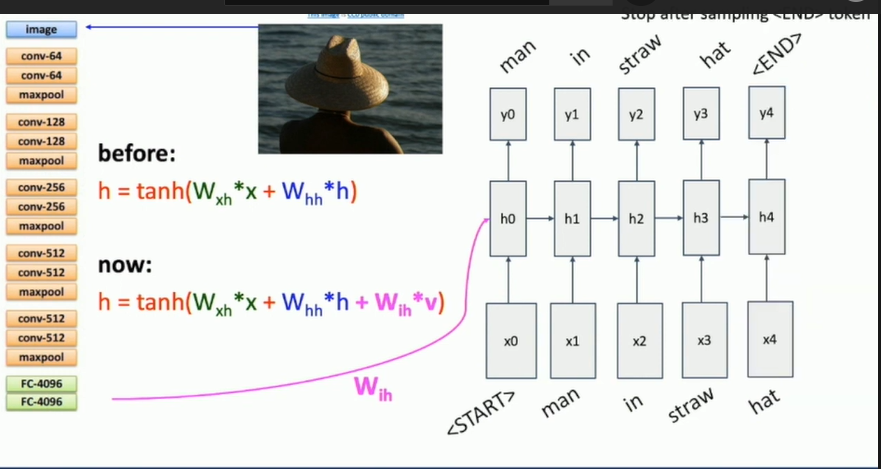

Gives good and garbarish results. 

82. Vanilla RNN Gradient Flow. 

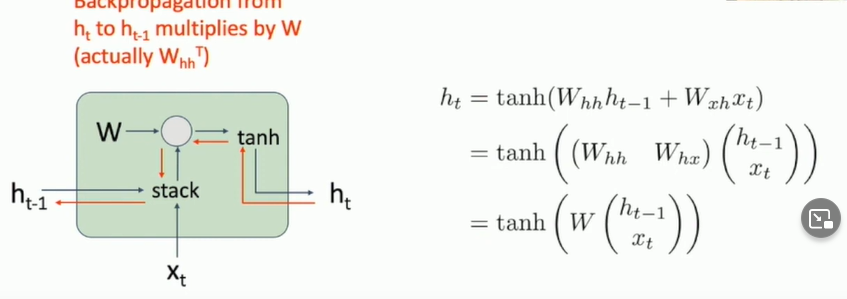

Problems

- $ tanh $ not good
- Backprop for W. This will transpose weight. So we will multiply the same matrix thousands or hundreds times. Also if singular value > 1 then exploding gradients. Otherwise vanishing gradients. 

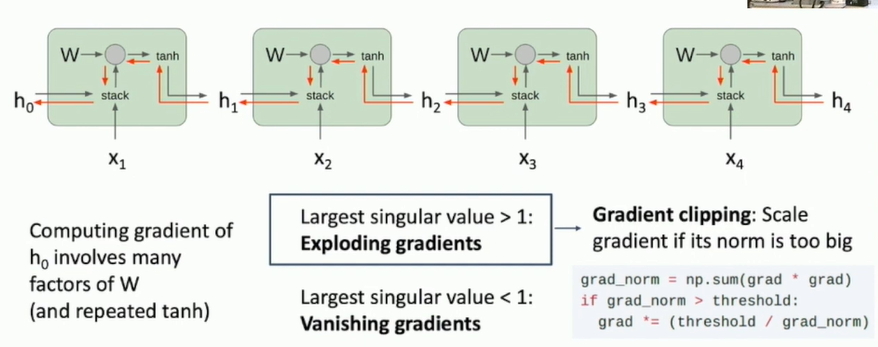

Gradient clipping.
For exploding gradients.  So we use gradient clipping. We multiply gradient by a coef to clip it if it reaches some threshold (see picture above).
For vanishing gradients. Throw away this arch and use diff architecture for RNN (LSTM?)

88. Long Short Term Memory (LSTM)

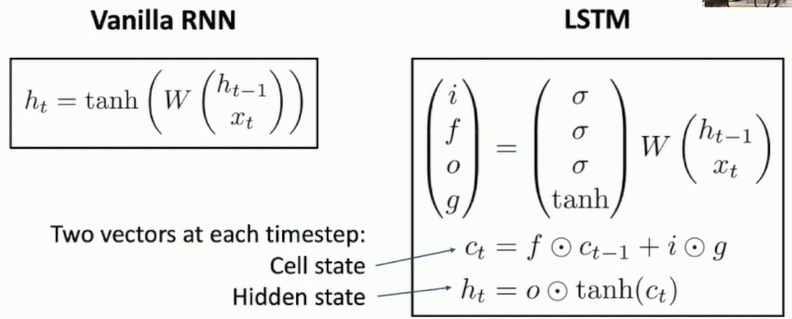

This computes not one gateway but four.

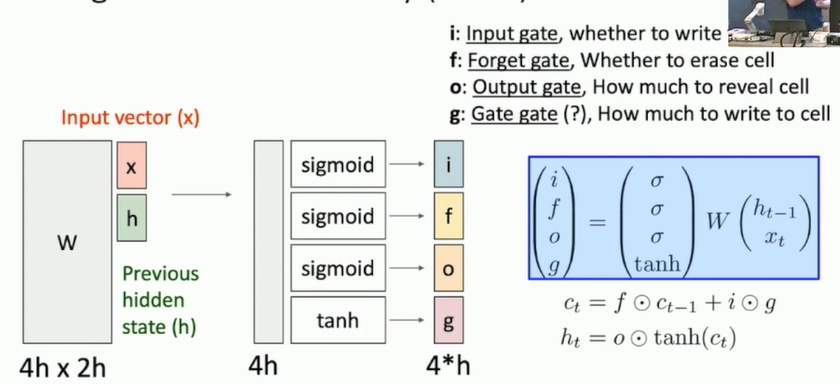

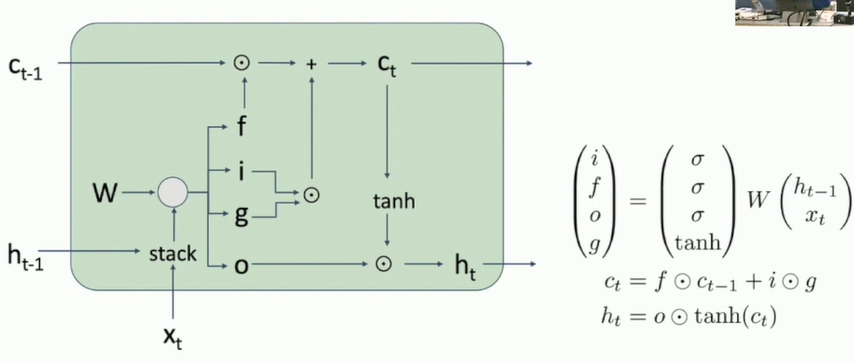

LSTM is to archieve better backprop. 

This reminds us about ResNet with those residual blocks. This is same idea with LSTM so it gets uninterrupted flow. Also there is Highway Networks. 

98. Multilayer RNNs

It was so far Single layer RNNs - one layer of those $ h_i $. So let's add many layers of those $ h^j_i $. With diff weight matrices for each layer.

101. Other RNN variants.
- GRU - improved LSTM.
- Also tried a brute force a formula for RNN (from 10K formulas). 
- Also they tried to search for architecture for RNN. 




### Questions 

7. Types of NN by number of input and output. Their examples. 
12. Applying RNN to non-sequential data. Examples. 
13. RNN
- What's key idea?
- Formula for a step.
18. Vanilla RNN
- Formula. How many weight matrices we use? How many weights per steps?
- How we compute loss? 
- Example for many-to-many.
28. Sequence to sequence. 
- Translation. What's encoder and decoder?
- Language Modelling. Predict next char.
    - What's input layer? Output layer?
44. How to train (Language model)
- Backprop through time. 
- Examples of for lang models.
63. Visualization (Language model)
- Coloring a text. What color means? 
70. Example of RNN + CNN. Image Captioning. 
82. Vanilla RNN gradient Flow. What problems?
88. Long Short Term Memory - LSTM
- How many states? Their names. 
98. Multilayer RNN

## Lecture 13. Attention

5/ Repeating RNN

Recaping to start with "attention" NN. Let's review previously discussed RNN.

The seq2seq with RNN is:

Input: sequence x_1, .., x_t
Output: sequence y_1, .., y_t

Example. Input might be text in one language and output would be text in other language.

This was done with two NN: encoder and decoder. 

Encoder - one NN. It will produce vector of hidden states $ h_i $, when given a sequence of input vectors $ x_i $. When we produced output we want to summarize all output into two vectors: $ s_0 $ (initial state for the decoder), $ c $ (context vector). Commonly $ c = h_t $. Decoder then takes initial state, context vector and initial input $ y_0 $ and produces the first word of output $ y_1 $. Then it repeats with the $ y_1 $. $ c $ serves important aim to summarize all info that decorder needs to decode. 

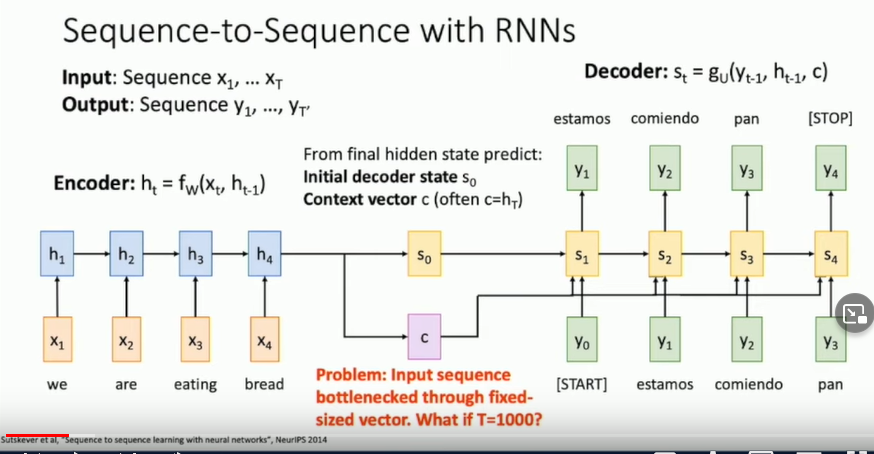

Problem is it works only when seq are short. But we want it to translate entire paragraphs or books. And it doesn't work with this small $ c $ context vector, this is a bottleneck. So let decoder recompute $ c $ vector at every step and it will 'focus' on diff parts of input each step. THis is formalized in 'attention' mechanizm.

12/ 

Attention. Still seq 2 seq. This allows to recompute context vector. Let's add alignemetn functions, i.e. small NN, that outputs a score that how much should we pay attention:

$ e_{t,i} = f_{att} (s_{t-1}, h_i) $

It says how much should we pay attention given current state of decoder, $ s_{t-1} $ and hidden state of encoder $ h_i $. 

So for the below picture:

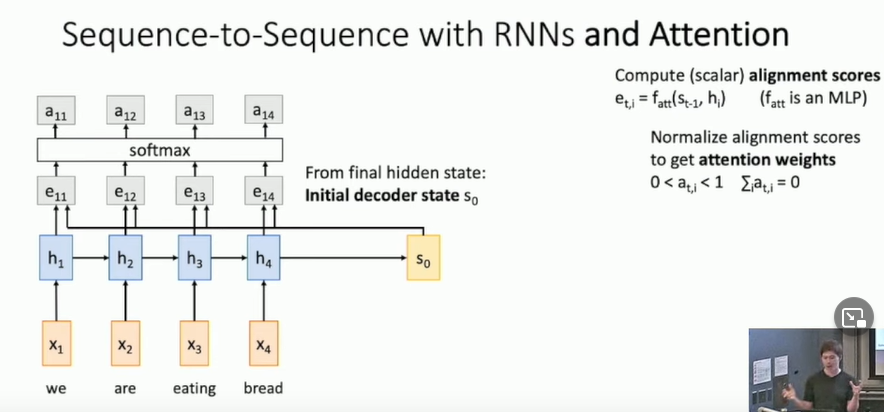

$ e_{1,1} $ (scalar) is this score of how we should pay attentions at step 1 given hidden state $ h_1 $ and initial state for the decoder $ s_0 $. Then we convert them to probabilities using softmax func (sum to 1). This distribution is 'attention weights' that says how much weight we should put on each hidden state of encoder given this state of decoder. 

Then we compute $ c_1 $ vector, context vector for decoder at step 1. As follows:

$ c_t = \sum_i a_{t,i} h_i $

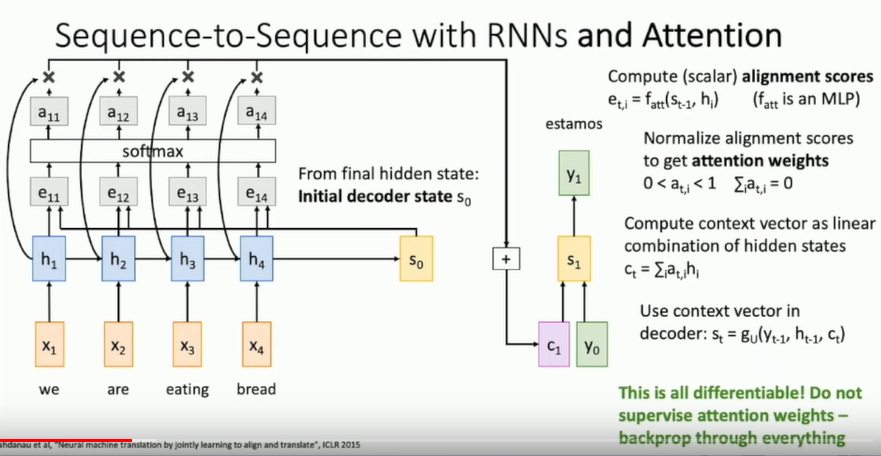

Then the decoder use this $ c_1 $ vector to output first token (or word) of the output sequence. 

Intuition is that context vector $ c_i $ is composed from $ a_{t,i} $ (scalar), and it tells if decoder should put more weight to this or that classes (types / words / tokens etc).  

This is all differentiable. We let NN decide by itself. We can backprop and compute gradients to let it decide for itself.

At step 2 we repeat the process to produce second output $ y_2 $ via computing $ c_2 $ that is computed by using $ s_1 $ (encoder uses decoder $ s_1 $), from those attention weights. Then it repeats.  

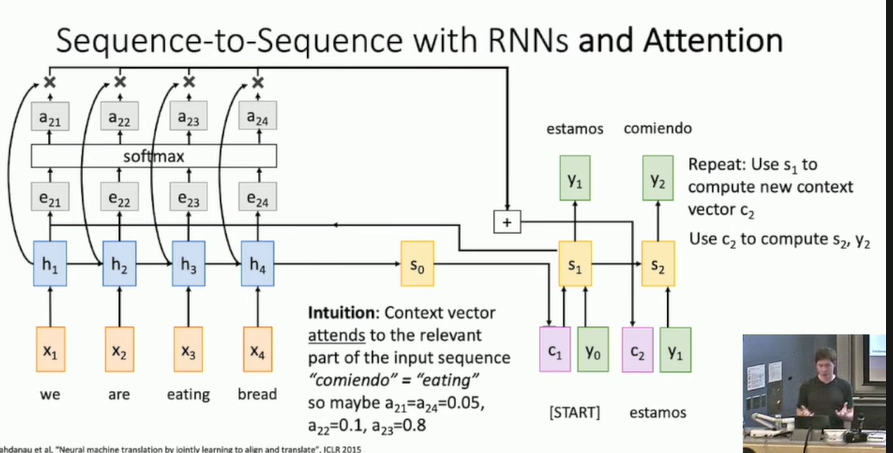

Pros:
- Overcome the problem with one 'bottleneck' vector $ c $. 
- At each timestep it focuses at diff parts. 

Example. From Eng to words in French. Trained seq 2 seq. The table of attention weights:

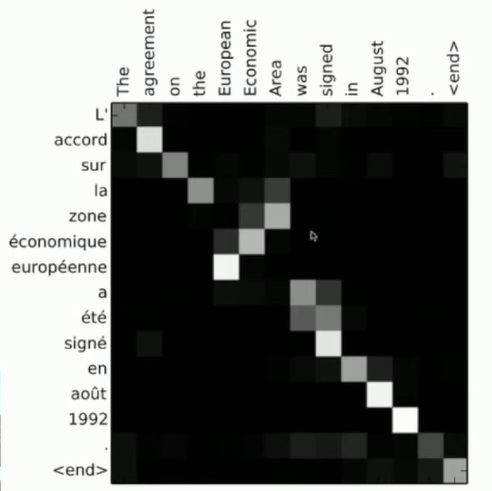

The above shows what weights were at each step for each word it produced. So what words correspond to what. It learns those itself! Model figures out it itself. It tells us how model makes decisions.

Cons: Attention mechanize doesn't know the fact that input is a sequence. So we can do it for non-seq input.

27/ 

Attention for non-seq input. Image Captioning with RNNs and Attention.

First we generate those hidden states: $ h_{i,j} $ using CNN, the final grid of feature vectors. On top of it we use attention mechanizm to compute $ e_{t,i,j} $, i.e. $ f_{att}(s_{t-1}, h_{i,j}) = e_{t,i,j} $. And then convert to probabilities using softmax. See image below:

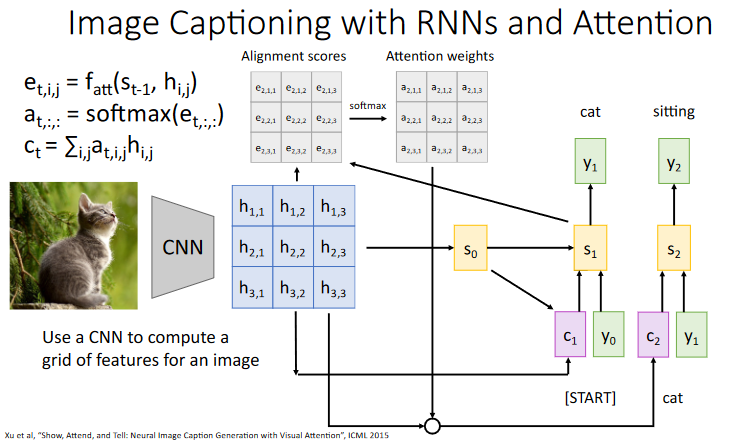

So we have attention weights for each part of the input. We then produce $ c_1 $ to get first word. Then repeat. Each time it looks at diff part of image. 

Q: Can model select a subset of features from image? A: Can but it differs from current topic.

Examples of attentions:

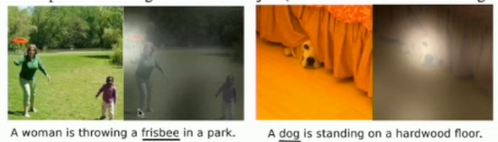

40\ Intuition behind attention

Human Vision: Fovea. Projected at retina. Retina has very small region that have high sensitivity (fovea) but others don't. Hence eyes constantly moves around to fix it - saccades mechanizm. So 'attention mechanizm' is simular that it focuses very rapidly at diff areas.

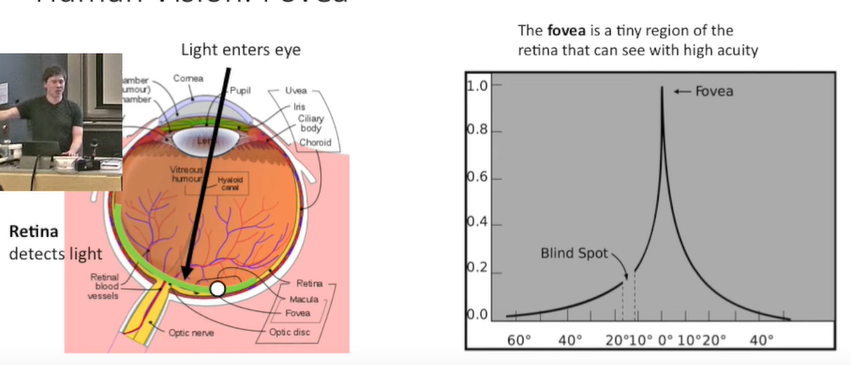

45\ X, Attend, and Y.

First paper: "Show, attend, and tell". Other would catch up this form: "X, Attend, and Y". "Listen, attend, and spell", 2016. Etc.

So often when we convert some info to other data we might use this attention.

46\ Attention Layer

Generilizing this mechinism. Let's reframe this mechanizm.

Inputs (see below):
- Query vector $ q $, like $ h_{i,j} $ as before, i.e. intermmediate hidden states we computed recursively from input in RNN.
- Input vecotrs: $ X $, corresponds to a set of vectors we want to attend (hidden vectors when it was on top of ConvNet).
- Similarity func, $ f_{att} $ is used to compare $ q $ with each of $ X $. 

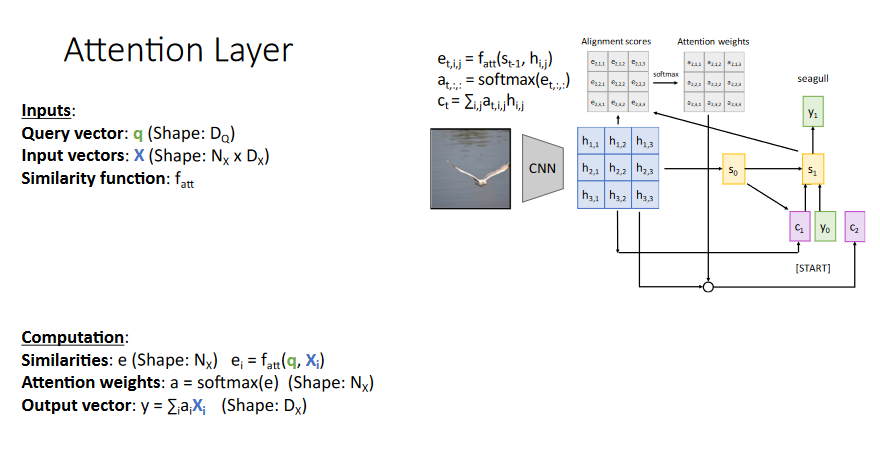

And it outputs:

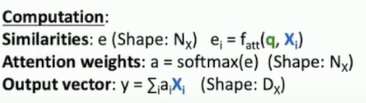

$ e $ - vector of simularities.
$ a $ - probabilities (as before) aka attention weights
$ y $ - output 

How to generilize? Generalizations:

1. Generalization 1. Use dot product. 
2. Scaled dot product: $ q X_i / sqrt(D_Q) $. Why? Because of the vanishing gradients problem. So learning is challenging. Remember that dot product uses norm of vectors. 
3. Multiple query vectors. Generate attentions for a set of queries. And we can get similarities for all those queries over all input vectors. And so for softmax and output vectors:

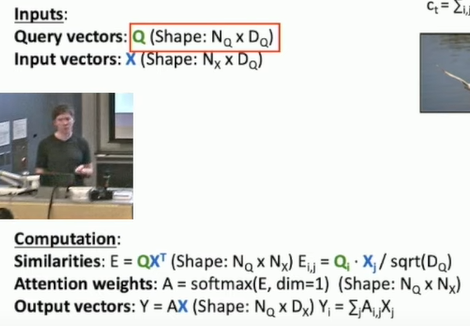

4. Separating input vector into key and value vectors because we used $ X $ for two diff operations (to get attention weights and to get output). And make them learnable. See image below. Why? More flexibility.

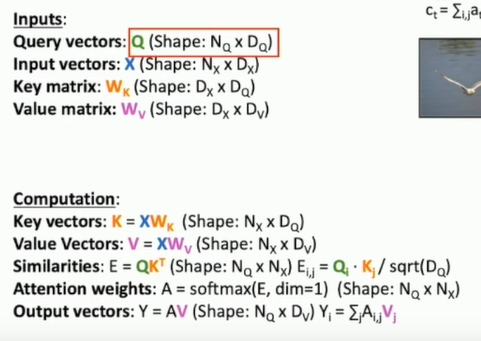

Example of this last generalization:

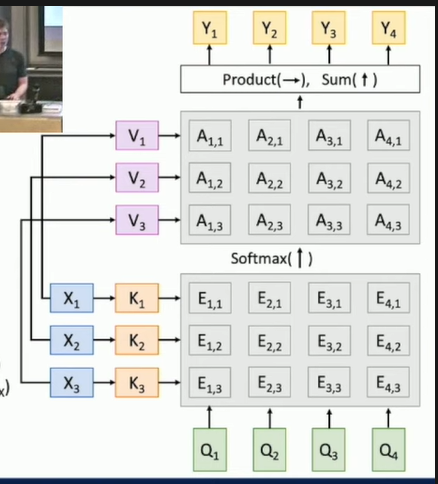

So we got very general attention layer. 

59\ Self-attention Layer

This is a special case of attention layer. One query per input vector. Now we have only one input vector without query vector. So we compare each input vector with every other input vector. 

First we convert input vector to query vector. Then ... See below:

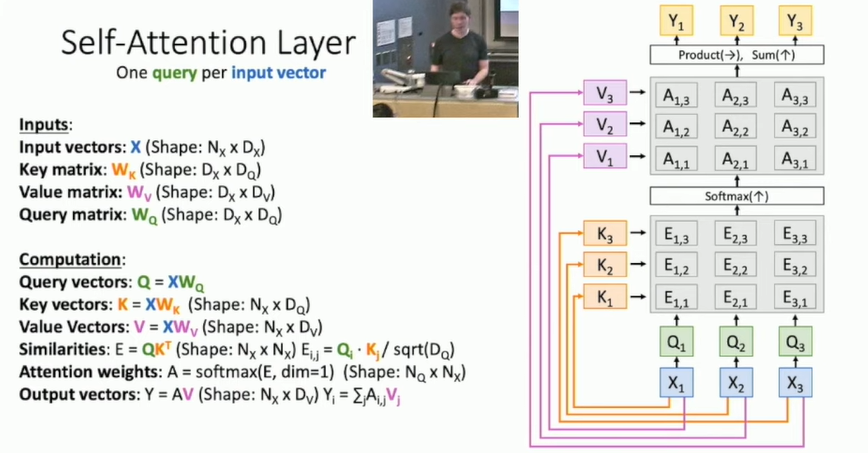

This is a very general mechanize. 

What if we change order of input vectors? It will give the same values but reordered, for query vector, for attention layer, etc. That means our layer is permutation equivariant (indifferent to permutations). 

Problem is it doesn't know the order. How to make it know the order? So make a hack: concatenate with positional encoding:

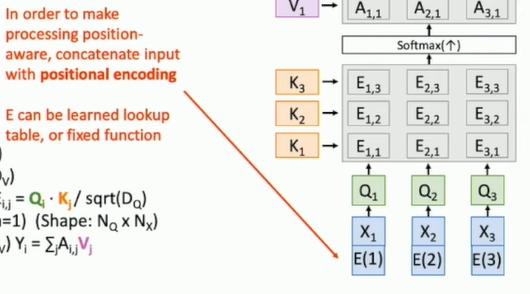

Now it knows what's beginiing, left / right, etc.

75\ Masked Self-Attention Layer.

To force a model not to use all the model. Use only information from a 'mask'. This is for language model, when we want a model to use only info from masked, only depend on some subset. So the model doesn't look ahead.

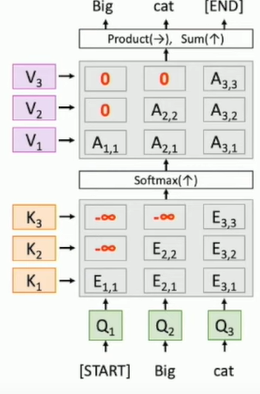

77\ Multihead Self-Attention Layer

Using independent 'attention heads' in parallel, i.e. separate attention layers.  

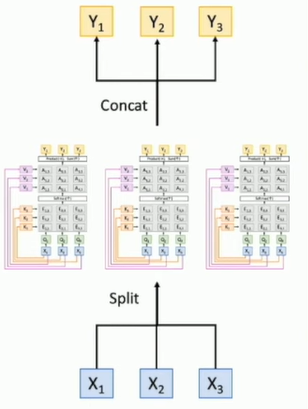

78\ Example of self-attention layer

First use CNN to create three sets: queries, keys and values. Then transpose and get attention weights. Then we use linear combination of attention weights and values to produced weighted values, how much we weight each position in input. Also it is commmon to add residual connection and conv layer. This is a new type of layer.

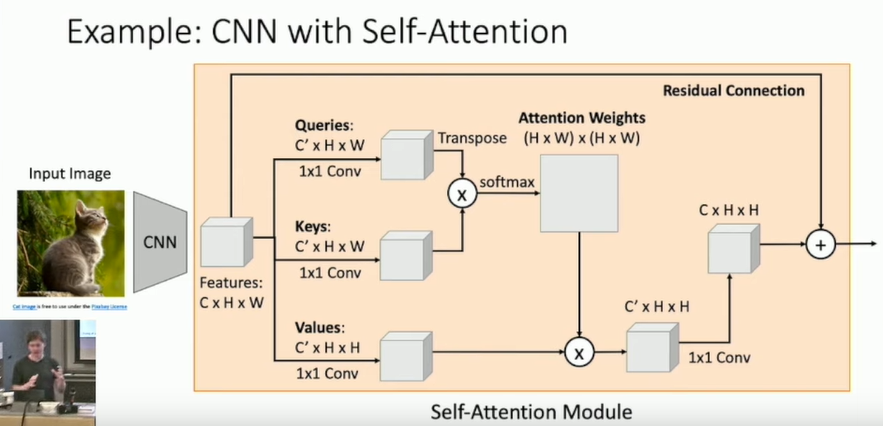


84\ How to process sequences?

1. Recurrent NN: (+) Good for long seqences.  (-) Not parallelizable.
2. ConvNets. 1D Convolution to process seq. And we slide it. (+) highly parallel. (-) Bad on long sequences, need to stack those conv layers. 
3. Self-attention. it overcomes prev minuses. (+) Good for long seq. (+) Highly parallel. (-) Takes a lot of memory.

87\ How can we combine those? "Attention is all you need". Transformers.

To process seq, we can use only self-attention mechanizm. 

How transformer block works. Receive X, then run through self-attention. Then redisidual connection. See below:

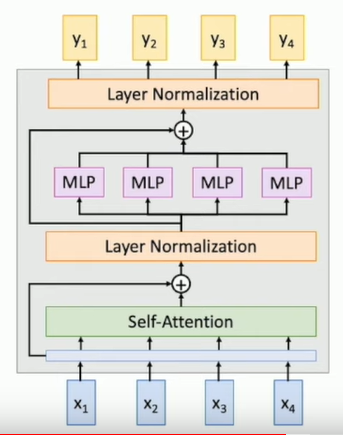

where

- Self-attention layer is the only place where interaction between vectors.
- MLP - feed forward layer,  multi-layer perceptron. per each vector independently.
- Layer Normalization per each vector independently.

(+) Highly parallizable, scallable. 

And transformer model is a sequence of transformer blocks. 

Significance of it? It is like ImageNet for NLP. 

Can be applied in many tasks in NLP. 

Labs compete with bigger and bigger models. Scalling up and up. GPT-2, RoBERTa, BERT-Base, BERT-Large, Megatron-LM, etc. 

As they bigger they are better.

We can generate text from transformers. Given text it produces other text.





### *Questions*

5\ How RNN works for language translation, many-to-many, decoder, encoder.
- What's bottleneck?

12\ Attention mechanism.
- What it computes? How computed? How context vector computed? How output computed?
- What's intuition behind this attention weights?
- What are pros?
- Example with language translation. Visualizing attention weights.

27\ Attention for non-sequencial data. 
- On top of CNN. How?  

40\ Intuition behind attention. Human vision. Retina and fovea.

46\ Attention Layer. Generalization. 

- What we have as input, as output.
- Ways to generilize:
    - Dot product
    - Scaled dot product
    - Multiple query vectors
    - Separation of input vector into key an value vectors.

59\ Self-Attention Layer

- What's difference from attention layer?
- Order of input vector. How to learn order?

75\ Masked Self-Attention Layer

- Idea? Used where?

77\ Multi-head Self-Attention Layer

- Idea? Why?


78\ CNN with Self-Attention

- Self-Attention Module.
- Queries, keys, values. 
- Attention weights
- Residual connection

84\ In general how to process sequences? 

- Using RNN. Upsides / downsides?
- Using CNN. Upsides / downsides?
- Self-attention. Upsides / downsides?

87\ Transformer. Attention is all you need.

- Transformer block constituents. 
- How significant is it?
- The bigger the better.